In [0]:
!nvidia-smi

Sat Jun 29 04:59:13 2019       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 418.67       Driver Version: 410.79       CUDA Version: 10.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   50C    P8    16W /  70W |      0MiB / 15079MiB |      0%      Default |
+-------------------------------+----------------------+----------------------+
                                                                               
+-----------------------------------------------------------------------------+
| Processes:                                                       GPU Memory |
|  GPU  

In [0]:
import random
import torch
import numpy as np
from pathlib import Path

import torch.nn.parallel
import torch.backends.cudnn as cudnn
from torch.utils.data import DataLoader, Dataset, SubsetRandomSampler
import torchvision.datasets as dset
import torchvision.transforms as transforms

import matplotlib.pyplot as plt
import shutil

import glob
import os
from PIL import Image

import torch.nn as nn 
import torch.nn.functional as F

import torch.optim as optim
from torch.autograd import Variable
import imageio

In [0]:
seed = 123
random.seed(seed)
torch.manual_seed(seed)
np.random.seed(seed)
print("My seed:", seed)

My seed: 123


In [0]:
DATA_PATH = Path('./data')
PATH = DATA_PATH / 'celeba'
PATH.mkdir(parents=True, exist_ok=True)

# Number of worker threads
workers = 2 # 2 cores available in colab

# Batch size
b_size = 128

# Spatial size of the training images. Resize to this size
image_size = 64

# Number of channels (Here it's 3 since RGB images)
nc = 3

# Size of latent vector
nz = 100

# Size of feature maps in generator
ngf = 64

# Size of feature maps in discriminator
ndf = 64

# Number of training epocs
num_epochs = 5

# Number of GPUs available. Use 0 for CPU mode.
ngpu = 1

# Important! The following line sets the device.
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

# Length of dataset
d_len = 202599

## Data

In [0]:
!wget https://s3-us-west-1.amazonaws.com/udacity-dlnfd/datasets/celeba.zip 

--2019-06-29 04:59:32--  https://s3-us-west-1.amazonaws.com/udacity-dlnfd/datasets/celeba.zip
Resolving s3-us-west-1.amazonaws.com (s3-us-west-1.amazonaws.com)... 52.219.120.48
Connecting to s3-us-west-1.amazonaws.com (s3-us-west-1.amazonaws.com)|52.219.120.48|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1443490838 (1.3G) [application/zip]
Saving to: ‘celeba.zip’

celeba.zip          100%[===================>]   1.34G  71.5MB/s    in 19s     

2019-06-29 04:59:51 (71.3 MB/s) - ‘celeba.zip’ saved [1443490838/1443490838]



In [0]:
from google.colab import drive
drive.mount('/content/drive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3Aietf%3Awg%3Aoauth%3A2.0%3Aoob&scope=email%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdocs.test%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive.photos.readonly%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fpeopleapi.readonly&response_type=code

Enter your authorization code:
··········
Mounted at /content/drive


In [0]:
!cp ./celeba.zip ./data/celeba

In [0]:
!unzip ./data/celeba/celeba.zip -d {PATH}

Archive:  ./data/celeba/celeba.zip
   creating: data/celeba/img_align_celeba/
 extracting: data/celeba/img_align_celeba/000001.jpg  
 extracting: data/celeba/img_align_celeba/000002.jpg  
 extracting: data/celeba/img_align_celeba/000003.jpg  
 extracting: data/celeba/img_align_celeba/000004.jpg  
 extracting: data/celeba/img_align_celeba/000005.jpg  
 extracting: data/celeba/img_align_celeba/000006.jpg  
 extracting: data/celeba/img_align_celeba/000007.jpg  
 extracting: data/celeba/img_align_celeba/000008.jpg  
 extracting: data/celeba/img_align_celeba/000009.jpg  
 extracting: data/celeba/img_align_celeba/000010.jpg  
 extracting: data/celeba/img_align_celeba/000011.jpg  
 extracting: data/celeba/img_align_celeba/000012.jpg  
 extracting: data/celeba/img_align_celeba/000013.jpg  
 extracting: data/celeba/img_align_celeba/000014.jpg  
 extracting: data/celeba/img_align_celeba/000015.jpg  
 extracting: data/celeba/img_align_celeba/000016.jpg  
 extracting: data/celeba/img_align_celeba/

In [0]:
!ls {PATH/'img_align_celeba'} | wc -l

202599


In [0]:
random.seed(seed)
torch.manual_seed(seed)
np.random.seed(seed)

noise_set = torch.randn(202599, nz, 1, 1, device=device)

## Creating fixed Gaussian noise

In [0]:
noise_set.mean(), noise_set.var(), noise_set[345].mean()

(tensor(-1.7165e-06, device='cuda:0'),
 tensor(1.0003, device='cuda:0'),
 tensor(-0.0501, device='cuda:0'))

## Creating datasets


In [0]:
class NoiseImageDataset(Dataset):
  def __init__(self, root, noise_set, transforms_=None):
    self.transform = transforms.Compose(transforms_)
    self.noise_set = noise_set
    
    self.files = sorted(glob.glob(os.path.join(root) + '/*.*'))
    self.len = len(self.files)
    
  def __getitem__(self, index):
    
    item = self.transform(Image.open(self.files[index % self.len]))
    
    noise = self.noise_set[index % self.len]
      
    return {'x': noise, 'y': item}
  
  def __len__(self):
    return self.len

In [0]:
dataset = NoiseImageDataset(root=PATH/'img_align_celeba',
                           noise_set=noise_set,
                           transforms_=[
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((.5,.5,.5), (.5,.5,.5)),
                           ])

dataloader = DataLoader(dataset, batch_size=b_size, 
                        shuffle=True, num_workers=0)

In [0]:
import matplotlib.pyplot as plt
import numpy as np
import torchvision.utils as vision_utils

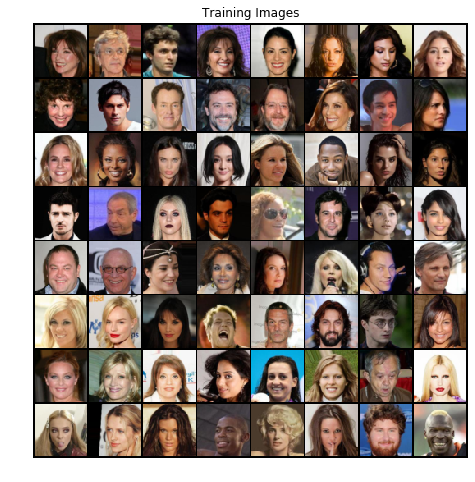

In [0]:
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vision_utils.make_grid(real_batch['y'].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

## Models

In [0]:

def weights_init_normal(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        torch.nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm2d') != -1:
        torch.nn.init.normal_(m.weight.data, 1.0, 0.02)
        torch.nn.init.constant_(m.bias.data, 0.0)

In [0]:
class SigmoidLayer(nn.Module):
  def __init__(self):
    super(SigmoidLayer, self).__init__()
    self.model = nn.Sequential(nn.Sigmoid())
    
  def forward(self, x):
    return self.model(x)

In [0]:
class GeneratorTemp(nn.Module):
  def __init__(self, in_channels, out_channels):
    super(GeneratorTemp, self).__init__()
    
    model = [
              nn.Conv2d(in_channels, out_channels, 3, stride=1, padding=1),
              nn.Tanh()
            ]
    
    self.model = nn.Sequential(*model)
    
  def forward(self, x):
    return self.model(x)

In [0]:
class DiscriminatorTemp(nn.Module):
  def __init__(self, in_channels, out_channels):
    super(DiscriminatorTemp, self).__init__()
    
    model = [
              nn.Conv2d(in_channels, out_channels, 3, stride=1, padding=1),
              nn.BatchNorm2d(out_channels),
              nn.LeakyReLU(0.2, inplace=True),
            ]
    
    self.model = nn.Sequential(*model)
    
  def forward(self, x):
    return self.model(x)

In [0]:
class GeneratorBlock(nn.Module):
  def __init__(self, in_channels, out_channels):
    super(GeneratorBlock, self).__init__()
    
    model = [
              nn.ConvTranspose2d(in_channels, out_channels, 4, stride=2, padding=1, bias=False),
              nn.BatchNorm2d(out_channels),
              nn.ReLU(True),
              nn.Conv2d(out_channels, out_channels, 3, stride=1, padding=1),
              nn.BatchNorm2d(out_channels),
              nn.ReLU(True),
            ]
    
    self.model = nn.Sequential(*model)
    
  def forward(self, x):
    return self.model(x)

In [0]:
class DiscriminatorBlock(nn.Module):
  def __init__(self, in_channels, out_channels):
    super(DiscriminatorBlock, self).__init__()
    
    model = [
              nn.Conv2d(in_channels, out_channels, 4, stride=2, padding=1),
              nn.BatchNorm2d(out_channels),
              nn.LeakyReLU(0.2, inplace=True),
              nn.Conv2d(out_channels, out_channels, 3, stride=1, padding=1),
              nn.BatchNorm2d(out_channels),
              nn.LeakyReLU(0.2, inplace=True),
            ]
    
    self.model = nn.Sequential(*model)
    
  def forward(self, x):
    return self.model(x)

In [0]:
class Generator(nn.Module):
  def __init__(self):
    super(Generator, self).__init__()    
    model = [
              nn.ConvTranspose2d(nz, ngf * 8, 4, 1, 0, bias=False),
              nn.BatchNorm2d(ngf * 8),
              nn.ReLU(True),
              nn.Conv2d(ndf * 8, ndf * 8, 3, stride=1, padding=1),
              nn.BatchNorm2d(ngf * 8),
              nn.ReLU(True),
            ]
    self.model = nn.Sequential(*model)
    
  def forward(self, x):
    return self.model(x)

In [0]:
class Discriminator(nn.Module):
  def __init__(self):
    super(Discriminator, self).__init__()    
    model = [
              nn.Conv2d(ndf * 8, ndf * 8, 3, 1, 1, bias=False),
              nn.BatchNorm2d(ndf * 8),
              nn.LeakyReLU(0.2, inplace=True),
              nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            ]
    self.model = nn.Sequential(*model)
    
  def forward(self, x):
    return self.model(x)

In [0]:
def initG(out_channels):
  netG = Generator().to(device)
  netG.apply(weights_init_normal)
  
  G_temp = GeneratorTemp(ngf * 8, out_channels).to(device)
  G_temp.apply(weights_init_normal)
  
  return nn.Sequential(netG, G_temp)

In [0]:
def addGenLayer(netG, in_channels, out_channels):
  G_layer = GeneratorBlock(in_channels, out_channels).to(device)
  G_layer.apply(weights_init_normal)
  removed = nn.Sequential(*list(netG.children())[:-1])
  
  G_temp = GeneratorTemp(out_channels, nc).to(device)
  G_temp.apply(weights_init_normal)
  
  return nn.Sequential(removed, G_layer, G_temp)

In [0]:
def initD(in_channels):
  D_temp = DiscriminatorTemp(in_channels, ndf * 8).to(device)
  D_temp.apply(weights_init_normal)
  
  netD = Discriminator().to(device)
  netD.apply(weights_init_normal)
  
  sig = SigmoidLayer().to(device)
  sig.apply(weights_init_normal)
  
  return nn.Sequential(D_temp, netD)

In [0]:
def addDisLayer(netD, in_channels, out_channels):
  D_layer = DiscriminatorBlock(in_channels, out_channels).to(device)
  D_layer.apply(weights_init_normal)
  removed = nn.Sequential(*list(netD.children())[1:])
  
  D_temp = DiscriminatorTemp(nc, in_channels).to(device)
  D_temp.apply(weights_init_normal)
  
  return nn.Sequential(D_temp, D_layer, removed)

In [0]:
class Critic(nn.Module):
  def __init__(self, ngpu):
    super(Critic, self).__init__()
    self.ngpu = ngpu
    self.main = nn.Sequential(
      nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
      nn.LeakyReLU(0.2, inplace=True),
        
      nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
      nn.BatchNorm2d(ndf * 2),
      nn.LeakyReLU(0.2, inplace=True),
        
      nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
      nn.BatchNorm2d(ndf * 4),
      nn.LeakyReLU(0.2, inplace=True),
        
      nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
      nn.BatchNorm2d(ndf * 8),
      nn.LeakyReLU(0.2, inplace=True),
        
      nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
    )
    
  def forward(self, input):
    return self.main(input).view(-1)

In [0]:
# Create the critic
netD = Critic(ngpu).to(device)
netD.apply(weights_init_normal)
print(netD)

Critic(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
  )
)


# Training

## 4x4 Images (Generator)

### Models

In [0]:
netG = initG(3)
print(netG)

Sequential(
  (0): Generator(
    (model): Sequential(
      (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
      (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace)
      (3): Conv2d(512, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (4): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (5): ReLU(inplace)
    )
  )
  (1): GeneratorTemp(
    (model): Sequential(
      (0): Conv2d(512, 3, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): Tanh()
    )
  )
)


### Dataloader

In [0]:
random.seed(seed)
torch.manual_seed(seed)
np.random.seed(seed)

In [0]:
dataset = NoiseImageDataset(root=PATH/'img_align_celeba',
                           noise_set=noise_set,
                           transforms_=[
                               transforms.Resize(image_size // 16),
                               transforms.CenterCrop(image_size // 16),
                               transforms.ToTensor(),
                               transforms.Normalize((.5,.5,.5), (.5,.5,.5)),
                           ])

dataloader = DataLoader(dataset, batch_size=b_size, 
                        shuffle=True, num_workers=0)

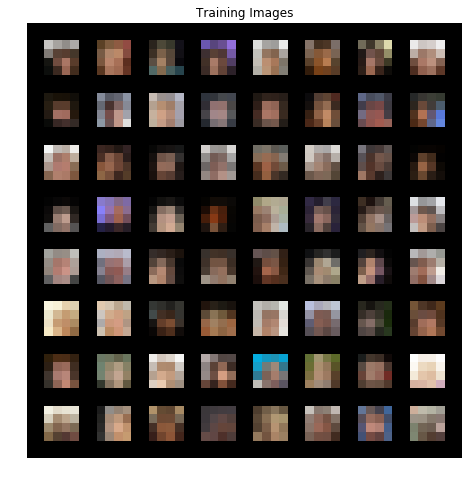

In [0]:
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vision_utils.make_grid(real_batch['y'].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

### Loss and other parameters

In [0]:
criterion = nn.L1Loss()

In [0]:
lr = 1e-3
n_epochs = 10
optimizer_G = optim.Adam(netG.parameters(), lr=lr, betas=(0.5, 0.999))
# optimizer_D = optim.Adam(netD.parameters(), lr=lr, betas=(0.5, 0.999))

### Memory Allocations

In [0]:
G_losses = []
Tensor = torch.cuda.FloatTensor
target = Tensor(b_size, 3, image_size//16, image_size//16)
# input_B = Tensor(b_size, 3, image_size//16, image_size//16)

In [0]:
target_real = Variable(Tensor(b_size).fill_(1.), requires_grad=False)
target_fake = Variable(Tensor(b_size).fill_(0.), requires_grad=False)

### Load Model

In [0]:
checkpoint = torch.load('./drive/My Drive/preG-final.pth')
netG.load_state_dict(checkpoint['model_state_dict'])
optimizer_G.load_state_dict(checkpoint['optimizer_state_dict'])
epoch = checkpoint['epoch']

netG.train()

Sequential(
  (0): Generator(
    (model): Sequential(
      (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
      (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace)
      (3): Conv2d(512, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (4): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (5): ReLU(inplace)
    )
  )
  (1): GeneratorTemp(
    (model): Sequential(
      (0): Conv2d(512, 3, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): Tanh()
    )
  )
)

In [0]:
import os
import shutil

In [0]:
for e in range(0 , n_epochs):
  for i, batch in enumerate(dataloader):
    
    if(batch['y'].shape[0] != b_size):
      continue

    # Set model inputs
    target_img = Variable(target.copy_(batch['y']))
    inp = batch['x']
    
    optimizer_G.zero_grad()
    
    # L1 Loss
    fake_img = netG(inp)
    loss_G = criterion(fake_img, target_img)
    loss_G.backward()
    
    optimizer_G.step()
    
    
    # Output training stats
    if i % 50 == 0:
        print('[%d/%d][%d/%d]\tLoss_G: %.4f'
              % (e, n_epochs, i, len(dataloader),
                 loss_G.item()))

    # Save Losses for plotting later
    G_losses.append(loss_G.item())
  
  if e % 5 == 0:
    torch.save({
            'epoch': e,
            'model_state_dict':netG.state_dict(),
            'optimizer_state_dict': optimizer_G.state_dict(),
            }, "./drive/My Drive/preG-{}.pth".format(e))

In [0]:
torch.save({
        'epoch': e,
        'model_state_dict':netG.state_dict(),
        'optimizer_state_dict': optimizer_G.state_dict(),
        }, "./drive/My Drive/preG-final.pth".format(e))

## 4x4 Images (Discriminator)

### Sampling Images

In [0]:
random.seed(seed)
torch.manual_seed(seed)
np.random.seed(seed)

In [0]:
# Sampling fake images
fake_samples = []
for i in range(1, d_len + 1):
  fixed_noise = noise_set[i-1]
  fake = netG(fixed_noise.unsqueeze(0)).detach().cpu().numpy()
  fake_samples.append(fake.squeeze(0))
  if i % 50000 == 0:
    print(i)

50000
100000
150000
200000


### Discriminator Dataloader

In [0]:
class DiscrimDataset(Dataset):
  def __init__(self, root, fake_samples, transforms_=None):
    self.transform = transforms.Compose(transforms_)
    
    self.files = sorted(glob.glob(os.path.join(root) + '/*.*'))
    self.fake_samples = fake_samples
    self.len = len(fake_samples)
    
  def __getitem__(self, index):
    rand = np.random.random_sample()
    if rand >= 0.5:
      item = self.transform(Image.open(self.files[index % self.len]))
      return {'x': item, 'y': 1}
    else:
      item = torch.from_numpy(self.fake_samples[index % self.len])
      return {'x': item, 'y': 0}
    
  
  def __len__(self):
    return self.len

In [0]:
dataset = DiscrimDataset(root=PATH/'img_align_celeba',
                           fake_samples=fake_samples,
                           transforms_=[
                               transforms.Resize(image_size // 16),
                               transforms.CenterCrop(image_size // 16),
                               transforms.ToTensor(),
                               transforms.Normalize((.5,.5,.5), (.5,.5,.5)),
                           ])

In [0]:
random.seed(seed)
torch.manual_seed(seed)
np.random.seed(seed)

In [0]:
# train validation split
validation_split = 0.1

dataset_len = len(dataset)
indices = list(range(dataset_len))

# Randomly splitting indices:
val_len = int(np.floor(validation_split * dataset_len))
validation_idx = np.random.choice(indices, size=val_len, replace=False)
train_idx = list(set(indices) - set(validation_idx))

# Samplers
train_sampler = SubsetRandomSampler(train_idx)
validation_sampler = SubsetRandomSampler(validation_idx)

# DataLoader
train_loader = DataLoader(dataset, sampler=train_sampler, batch_size=b_size)
validation_loader = DataLoader(dataset, sampler=validation_sampler, batch_size=b_size)
data_loaders = {"train": train_loader, "val": validation_loader}
data_lengths = {"train": len(train_idx), "val": val_len}

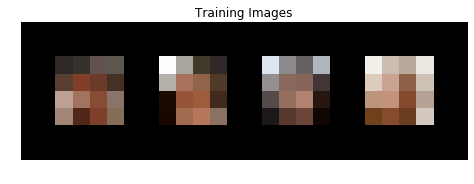

In [0]:
real_batch = next(iter(train_loader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vision_utils.make_grid(real_batch['x'][:4].to(device), padding=2, normalize=True).cpu(),(1,2,0)))

### Model

In [0]:
random.seed(seed)
torch.manual_seed(seed)
np.random.seed(seed)

In [0]:
netD = initD(3)
netD

Sequential(
  (0): DiscriminatorTemp(
    (model): Sequential(
      (0): Conv2d(3, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace)
    )
  )
  (1): Discriminator(
    (model): Sequential(
      (0): Conv2d(512, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace)
      (3): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    )
  )
  (2): SigmoidLayer(
    (model): Sequential(
      (0): Sigmoid()
    )
  )
)

### Loss and other parameters

In [0]:
criterion = nn.BCELoss()

In [0]:
lr = 1e-3
n_epochs = 10
optimizer_D = optim.Adam(netD.parameters(), lr=lr, betas=(0.5, 0.999))

In [0]:
D_train_losses = []
D_valid_losses = []

In [0]:
checkpoint = torch.load('./drive/My Drive/preD-best.pth')
netD.load_state_dict(checkpoint['model_state_dict'])
optimizer_D.load_state_dict(checkpoint['optimizer_state_dict'])
epoch = checkpoint['epoch']

netD.train()

Sequential(
  (0): DiscriminatorTemp(
    (model): Sequential(
      (0): Conv2d(3, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace)
    )
  )
  (1): Discriminator(
    (model): Sequential(
      (0): Conv2d(512, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace)
      (3): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    )
  )
  (2): SigmoidLayer(
    (model): Sequential(
      (0): Sigmoid()
    )
  )
)

In [0]:
valid_loss_min = np.Inf # track change in validation loss

for epoch in range(1, n_epochs+1):

    # keep track of training and validation loss
    train_loss = 0.0
    valid_loss = 0.0
    
    # train the model #
    netD.train()
    for data in train_loader:
        img = data['x'].cuda()
        target = torch.FloatTensor(data['y'].numpy()).cuda()
        # clear the gradients of all optimized variables
        optimizer_D.zero_grad()
        # forward pass: compute predicted outputs by passing inputs to the model
        output = netD(img)
        # calculate the batch loss
        loss = criterion(output, target)
        # backward pass: compute gradient of the loss with respect to model parameters
        loss.backward()
        # perform a single optimization step (parameter update)
        optimizer_D.step()
        # update training loss
        train_loss += loss.item()*data['x'].size(0)
        
    # Validating the model
    netD.eval()
    for data in validation_loader:
        img = data['x'].cuda()
        target = torch.FloatTensor(data['y'].numpy()).cuda()
        # forward pass: compute predicted outputs by passing inputs to the model
        output = netD(img)
        # calculate the batch loss
        loss = criterion(output, target)
        # update average validation loss 
        valid_loss += loss.item()*data['x'].size(0)
    
    # calculate average losses
    train_loss = train_loss/len(train_loader.dataset)
    valid_loss = valid_loss/len(validation_loader.dataset)
        
    # print training/validation statistics 
    print('Epoch: {} \tTraining Loss: {:.6f} \tValidation Loss: {:.6f}'.format(
        epoch, train_loss, valid_loss))
    
    # save model if validation loss has decreased
    if valid_loss <= valid_loss_min:
        print('Validation loss decreased ({:.6f} --> {:.6f}).  Saving model ...'.format(
        valid_loss_min,
        valid_loss))
        torch.save({
                'epoch': epoch,
                'model_state_dict':netD.state_dict(),
                'optimizer_state_dict': optimizer_D.state_dict(),
                }, "./drive/My Drive/preD-best.pth")
        valid_loss_min = valid_loss

/usr/local/lib/python3.6/dist-packages/torch/nn/modules/loss.py:512: UserWarning: Using a target size (torch.Size([128])) that is different to the input size (torch.Size([128, 1, 1, 1])) is deprecated. Please ensure they have the same size.
  return F.binary_cross_entropy(input, target, weight=self.weight, reduction=self.reduction)
/usr/local/lib/python3.6/dist-packages/torch/nn/modules/loss.py:512: UserWarning: Using a target size (torch.Size([68])) that is different to the input size (torch.Size([68, 1, 1, 1])) is deprecated. Please ensure they have the same size.
  return F.binary_cross_entropy(input, target, weight=self.weight, reduction=self.reduction)
/usr/local/lib/python3.6/dist-packages/torch/nn/modules/loss.py:512: UserWarning: Using a target size (torch.Size([35])) that is different to the input size (torch.Size([35, 1, 1, 1])) is deprecated. Please ensure they have the same size.
  return F.binary_cross_entropy(input, target, weight=self.weight, reduction=self.reduction)


Epoch: 1 	Training Loss: 0.082484 	Validation Loss: 0.006704
Validation loss decreased (inf --> 0.006704).  Saving model ...
Epoch: 2 	Training Loss: 0.025555 	Validation Loss: 0.002045
Validation loss decreased (0.006704 --> 0.002045).  Saving model ...
Epoch: 3 	Training Loss: 0.019184 	Validation Loss: 0.001397
Validation loss decreased (0.002045 --> 0.001397).  Saving model ...
Epoch: 4 	Training Loss: 0.016324 	Validation Loss: 0.003855
Epoch: 5 	Training Loss: 0.014680 	Validation Loss: 0.001076
Validation loss decreased (0.001397 --> 0.001076).  Saving model ...
Epoch: 6 	Training Loss: 0.012746 	Validation Loss: 0.001103
Epoch: 7 	Training Loss: 0.011013 	Validation Loss: 0.001092
Epoch: 8 	Training Loss: 0.009994 	Validation Loss: 0.000773
Validation loss decreased (0.001076 --> 0.000773).  Saving model ...
Epoch: 9 	Training Loss: 0.009399 	Validation Loss: 0.000732
Validation loss decreased (0.000773 --> 0.000732).  Saving model ...
Epoch: 10 	Training Loss: 0.008865 	Valida

## Upscale (8 x 8)

### Model

In [0]:
netG = addGenLayer(netG, ngf * 8, ngf * 4)
netG

Sequential(
  (0): Sequential(
    (0): Generator(
      (model): Sequential(
        (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
        (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (2): ReLU(inplace)
        (3): Conv2d(512, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (4): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (5): ReLU(inplace)
      )
    )
  )
  (1): GeneratorBlock(
    (model): Sequential(
      (0): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace)
      (3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (5): ReLU(inplace)
    )
  )
  (2): GeneratorTemp(
  

### DataLoader

In [0]:
random.seed(seed)
torch.manual_seed(seed)
np.random.seed(seed)

In [0]:
dataset = NoiseImageDataset(root=PATH/'img_align_celeba',
                           noise_set=noise_set,
                           transforms_=[
                               transforms.Resize(image_size // 8),
                               transforms.CenterCrop(image_size // 8),
                               transforms.ToTensor(),
                               transforms.Normalize((.5,.5,.5), (.5,.5,.5)),
                           ])

dataloader = DataLoader(dataset, batch_size=b_size, 
                        shuffle=True, num_workers=0)

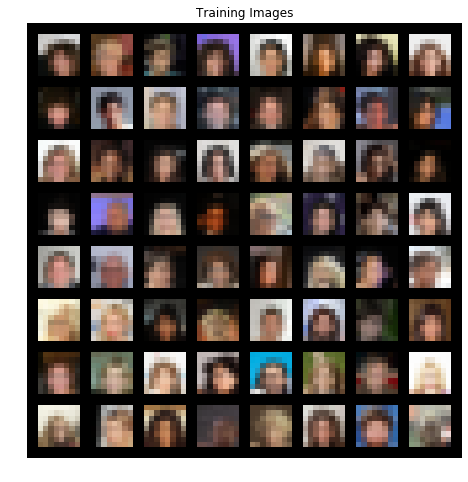

In [0]:
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vision_utils.make_grid(real_batch['y'].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

### Parameters

In [0]:
criterion = nn.L1Loss()

In [0]:
lr = 1e-3
n_epochs = 10
optimizer_G = optim.Adam(netG.parameters(), lr=lr, betas=(0.5, 0.999))
# optimizer_D = optim.Adam(netD.parameters(), lr=lr, betas=(0.5, 0.999))

### Memory Allocations

In [0]:
G_losses = []
Tensor = torch.cuda.FloatTensor
target = Tensor(b_size, 3, image_size//8, image_size//8)
# input_B = Tensor(b_size, 3, image_size//16, image_size//16)

In [0]:
target_real = Variable(Tensor(b_size).fill_(1.), requires_grad=False)
target_fake = Variable(Tensor(b_size).fill_(0.), requires_grad=False)

### Training

In [0]:
checkpoint = torch.load('./drive/My Drive/preG-8-final.pth')
netG.load_state_dict(checkpoint['model_state_dict'])
optimizer_G.load_state_dict(checkpoint['optimizer_state_dict'])
epoch = checkpoint['epoch']

netG.train()

Sequential(
  (0): Sequential(
    (0): Generator(
      (model): Sequential(
        (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
        (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (2): ReLU(inplace)
        (3): Conv2d(512, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (4): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (5): ReLU(inplace)
      )
    )
  )
  (1): GeneratorBlock(
    (model): Sequential(
      (0): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace)
      (3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (5): ReLU(inplace)
    )
  )
  (2): GeneratorTemp(
  

In [0]:
import os
import shutil

In [0]:
for e in range(0 , n_epochs):
  for i, batch in enumerate(dataloader):
    
    if(batch['y'].shape[0] != b_size):
      continue

    # Set model inputs
    target_img = Variable(target.copy_(batch['y']))
    inp = batch['x']
    
    optimizer_G.zero_grad()
    
    # L1 Loss
    fake_img = netG(inp)
    loss_G = criterion(fake_img, target_img)
    loss_G.backward()
    
    optimizer_G.step()
    
    
    # Output training stats
    if i % 50 == 0:
        print('[%d/%d][%d/%d]\tLoss_G: %.4f'
              % (e, n_epochs, i, len(dataloader),
                 loss_G.item()))

    # Save Losses for plotting later
    G_losses.append(loss_G.item())
  
  if e % 5 == 0:
    torch.save({
            'epoch': e,
            'model_state_dict':netG.state_dict(),
            'optimizer_state_dict': optimizer_G.state_dict(),
            }, "./drive/My Drive/preG-8-{}.pth".format(e))

[0/10][0/1583]	Loss_G: 0.5533
[0/10][50/1583]	Loss_G: 0.2499
[0/10][100/1583]	Loss_G: 0.2546
[0/10][150/1583]	Loss_G: 0.2344
[0/10][200/1583]	Loss_G: 0.2505
[0/10][250/1583]	Loss_G: 0.2400
[0/10][300/1583]	Loss_G: 0.2227
[0/10][350/1583]	Loss_G: 0.2340
[0/10][400/1583]	Loss_G: 0.2386
[0/10][450/1583]	Loss_G: 0.2384
[0/10][500/1583]	Loss_G: 0.2320
[0/10][550/1583]	Loss_G: 0.2240
[0/10][600/1583]	Loss_G: 0.2327
[0/10][650/1583]	Loss_G: 0.2298
[0/10][700/1583]	Loss_G: 0.2260
[0/10][750/1583]	Loss_G: 0.2255
[0/10][800/1583]	Loss_G: 0.2172
[0/10][850/1583]	Loss_G: 0.2319
[0/10][900/1583]	Loss_G: 0.2227
[0/10][950/1583]	Loss_G: 0.2248
[0/10][1000/1583]	Loss_G: 0.2225
[0/10][1050/1583]	Loss_G: 0.2172
[0/10][1100/1583]	Loss_G: 0.2300
[0/10][1150/1583]	Loss_G: 0.2264
[0/10][1200/1583]	Loss_G: 0.2192
[0/10][1250/1583]	Loss_G: 0.2306
[0/10][1300/1583]	Loss_G: 0.2144
[0/10][1350/1583]	Loss_G: 0.2167
[0/10][1400/1583]	Loss_G: 0.2227
[0/10][1450/1583]	Loss_G: 0.2324
[0/10][1500/1583]	Loss_G: 0.2178


In [0]:
torch.save({
        'epoch': e,
        'model_state_dict':netG.state_dict(),
        'optimizer_state_dict': optimizer_G.state_dict(),
        }, "./drive/My Drive/preG-8-final.pth".format(e))

## 8x8 Images (Discriminator)

### Sampling Images

In [0]:
random.seed(seed)
torch.manual_seed(seed)
np.random.seed(seed)

In [0]:
# Sampling fake images
fake_samples = []
for i in range(1, d_len + 1):
  fixed_noise = noise_set[i-1]
  fake = netG(fixed_noise.unsqueeze(0)).detach().cpu().numpy()
  fake_samples.append(fake.squeeze(0))
  if i % 50000 == 0:
    print(i)

50000
100000
150000
200000


### DataLoader


In [0]:
class DiscrimDataset(Dataset):
  def __init__(self, root, fake_samples, transforms_=None):
    self.transform = transforms.Compose(transforms_)
    
    self.files = sorted(glob.glob(os.path.join(root) + '/*.*'))
    self.fake_samples = fake_samples
    self.len = len(fake_samples)
    
  def __getitem__(self, index):
    rand = np.random.random_sample()
    if rand >= 0.5:
      item = self.transform(Image.open(self.files[index % self.len]))
      return {'x': item, 'y': 1}
    else:
      item = torch.from_numpy(self.fake_samples[index % self.len])
      return {'x': item, 'y': 0}
    
  
  def __len__(self):
    return self.len

In [0]:
dataset = DiscrimDataset(root=PATH/'img_align_celeba',
                           fake_samples=fake_samples,
                           transforms_=[
                               transforms.Resize(image_size // 8),
                               transforms.CenterCrop(image_size // 8),
                               transforms.ToTensor(),
                               transforms.Normalize((.5,.5,.5), (.5,.5,.5)),
                           ])

In [0]:
random.seed(seed)
torch.manual_seed(seed)
np.random.seed(seed)

In [0]:
# train validation split
validation_split = 0.1

dataset_len = len(dataset)
indices = list(range(dataset_len))

# Randomly splitting indices:
val_len = int(np.floor(validation_split * dataset_len))
validation_idx = np.random.choice(indices, size=val_len, replace=False)
train_idx = list(set(indices) - set(validation_idx))

# Samplers
train_sampler = SubsetRandomSampler(train_idx)
validation_sampler = SubsetRandomSampler(validation_idx)

# DataLoader
train_loader = DataLoader(dataset, sampler=train_sampler, batch_size=b_size)
validation_loader = DataLoader(dataset, sampler=validation_sampler, batch_size=b_size)
data_loaders = {"train": train_loader, "val": validation_loader}
data_lengths = {"train": len(train_idx), "val": val_len}

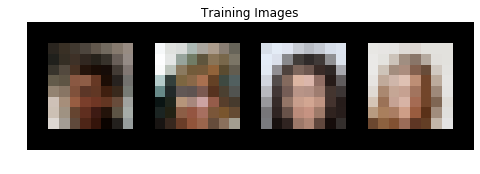

In [0]:
real_batch = next(iter(train_loader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vision_utils.make_grid(real_batch['x'][:4].to(device), padding=2, normalize=True).cpu(),(1,2,0)))

### Model

In [0]:
checkpoint = torch.load('./drive/My Drive/preD-best.pth')
netD.load_state_dict(checkpoint['model_state_dict'])
optimizer_D.load_state_dict(checkpoint['optimizer_state_dict'])
epoch = checkpoint['epoch']

netD.train()

Sequential(
  (0): DiscriminatorTemp(
    (model): Sequential(
      (0): Conv2d(3, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace)
    )
  )
  (1): Discriminator(
    (model): Sequential(
      (0): Conv2d(512, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace)
      (3): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    )
  )
  (2): SigmoidLayer(
    (model): Sequential(
      (0): Sigmoid()
    )
  )
)

In [0]:
random.seed(seed)
torch.manual_seed(seed)
np.random.seed(seed)

In [0]:
netD = addDisLayer(netD, ndf * 4, ndf * 8)
netD

Sequential(
  (0): DiscriminatorTemp(
    (model): Sequential(
      (0): Conv2d(3, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace)
    )
  )
  (1): DiscriminatorBlock(
    (model): Sequential(
      (0): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
      (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace)
      (3): Conv2d(512, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (4): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (5): LeakyReLU(negative_slope=0.2, inplace)
    )
  )
  (2): Sequential(
    (0): Discriminator(
      (model): Sequential(
        (0): Conv2d(512, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (1): BatchNorm2d(512, eps=1e-05, 

### Loss and other parameters

In [0]:
criterion = nn.BCELoss()

In [0]:
lr = 1e-3
n_epochs = 10
optimizer_D = optim.Adam(netD.parameters(), lr=lr, betas=(0.5, 0.999))

In [0]:
D_train_losses = []
D_valid_losses = []

In [0]:
valid_loss_min = np.Inf # track change in validation loss

for epoch in range(1, n_epochs+1):

    # keep track of training and validation loss
    train_loss = 0.0
    valid_loss = 0.0
    
    # train the model #
    netD.train()
    for data in train_loader:
        img = data['x'].cuda()
        target = torch.FloatTensor(data['y'].numpy()).cuda()
        # clear the gradients of all optimized variables
        optimizer_D.zero_grad()
        # forward pass: compute predicted outputs by passing inputs to the model
        output = netD(img)
        # calculate the batch loss
        loss = criterion(output, target)
        # backward pass: compute gradient of the loss with respect to model parameters
        loss.backward()
        # perform a single optimization step (parameter update)
        optimizer_D.step()
        # update training loss
        train_loss += loss.item()*data['x'].size(0)
        
    # Validating the model
    netD.eval()
    for data in validation_loader:
        img = data['x'].cuda()
        target = torch.FloatTensor(data['y'].numpy()).cuda()
        # forward pass: compute predicted outputs by passing inputs to the model
        output = netD(img)
        # calculate the batch loss
        loss = criterion(output, target)
        # update average validation loss 
        valid_loss += loss.item()*data['x'].size(0)
    
    # calculate average losses
    train_loss = train_loss/len(train_loader.dataset)
    valid_loss = valid_loss/len(validation_loader.dataset)
        
    # print training/validation statistics 
    print('Epoch: {} \tTraining Loss: {:.6f} \tValidation Loss: {:.6f}'.format(
        epoch, train_loss, valid_loss))
    
    # save model if validation loss has decreased
    if valid_loss <= valid_loss_min:
        print('Validation loss decreased ({:.6f} --> {:.6f}).  Saving model ...'.format(
        valid_loss_min,
        valid_loss))
        torch.save({
                'epoch': epoch,
                'model_state_dict':netD.state_dict(),
                'optimizer_state_dict': optimizer_D.state_dict(),
                }, "./drive/My Drive/preD-8-best.pth")
        valid_loss_min = valid_loss

/usr/local/lib/python3.6/dist-packages/torch/nn/modules/loss.py:512: UserWarning: Using a target size (torch.Size([128])) that is different to the input size (torch.Size([128, 1, 1, 1])) is deprecated. Please ensure they have the same size.
  return F.binary_cross_entropy(input, target, weight=self.weight, reduction=self.reduction)
/usr/local/lib/python3.6/dist-packages/torch/nn/modules/loss.py:512: UserWarning: Using a target size (torch.Size([68])) that is different to the input size (torch.Size([68, 1, 1, 1])) is deprecated. Please ensure they have the same size.
  return F.binary_cross_entropy(input, target, weight=self.weight, reduction=self.reduction)
/usr/local/lib/python3.6/dist-packages/torch/nn/modules/loss.py:512: UserWarning: Using a target size (torch.Size([35])) that is different to the input size (torch.Size([35, 1, 1, 1])) is deprecated. Please ensure they have the same size.
  return F.binary_cross_entropy(input, target, weight=self.weight, reduction=self.reduction)


Epoch: 1 	Training Loss: 0.874205 	Validation Loss: 0.000459
Validation loss decreased (inf --> 0.000459).  Saving model ...
Epoch: 2 	Training Loss: 0.007835 	Validation Loss: 0.003427
Epoch: 3 	Training Loss: 0.004469 	Validation Loss: 0.000062
Validation loss decreased (0.000459 --> 0.000062).  Saving model ...
Epoch: 4 	Training Loss: 0.008151 	Validation Loss: 0.000200
Epoch: 5 	Training Loss: 0.003158 	Validation Loss: 0.000154
Epoch: 6 	Training Loss: 0.005640 	Validation Loss: 0.000185
Epoch: 7 	Training Loss: 0.002029 	Validation Loss: 0.000143
Epoch: 8 	Training Loss: 0.002055 	Validation Loss: 0.000077
Epoch: 9 	Training Loss: 0.002147 	Validation Loss: 0.000133
Epoch: 10 	Training Loss: 0.001494 	Validation Loss: 0.000094


In [0]:
checkpoint = torch.load('./drive/My Drive/preD-8-best.pth')
netD.load_state_dict(checkpoint['model_state_dict'])
optimizer_D.load_state_dict(checkpoint['optimizer_state_dict'])
epoch = checkpoint['epoch']

netD.train()

Sequential(
  (0): DiscriminatorTemp(
    (model): Sequential(
      (0): Conv2d(3, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace)
    )
  )
  (1): DiscriminatorBlock(
    (model): Sequential(
      (0): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
      (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace)
      (3): Conv2d(512, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (4): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (5): LeakyReLU(negative_slope=0.2, inplace)
    )
  )
  (2): Sequential(
    (0): Discriminator(
      (model): Sequential(
        (0): Conv2d(512, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (1): BatchNorm2d(512, eps=1e-05, 

## Upscale (16x 16)

### Model

In [0]:
netG = addGenLayer(netG, ngf * 4, ngf * 2)
netG

Sequential(
  (0): Sequential(
    (0): Sequential(
      (0): Generator(
        (model): Sequential(
          (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
          (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (2): ReLU(inplace)
          (3): Conv2d(512, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
          (4): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (5): ReLU(inplace)
        )
      )
    )
    (1): GeneratorBlock(
      (model): Sequential(
        (0): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
        (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (2): ReLU(inplace)
        (3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  

### DataLoader

In [0]:
random.seed(seed)
torch.manual_seed(seed)
np.random.seed(seed)

In [0]:
dataset = NoiseImageDataset(root=PATH/'img_align_celeba',
                           noise_set=noise_set,
                           transforms_=[
                               transforms.Resize(image_size // 4),
                               transforms.CenterCrop(image_size // 4),
                               transforms.ToTensor(),
                               transforms.Normalize((.5,.5,.5), (.5,.5,.5)),
                           ])

dataloader = DataLoader(dataset, batch_size=b_size, 
                        shuffle=True, num_workers=0)

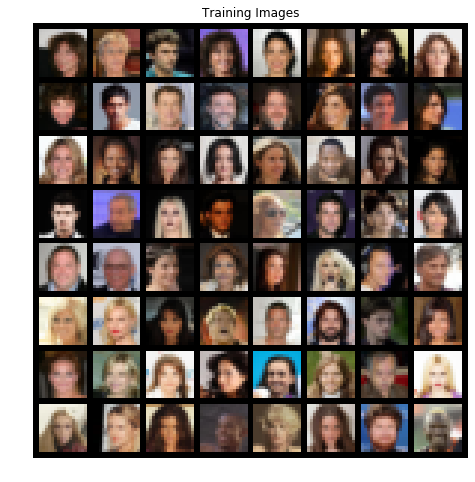

In [0]:
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vision_utils.make_grid(real_batch['y'].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

### Parameters

In [0]:
criterion = nn.L1Loss()

In [0]:
lr = 1e-3
n_epochs = 10
optimizer_G = optim.Adam(netG.parameters(), lr=lr, betas=(0.5, 0.999))
# optimizer_D = optim.Adam(netD.parameters(), lr=lr, betas=(0.5, 0.999))

### Memory Allocations

In [0]:
G_losses = []
Tensor = torch.cuda.FloatTensor
target = Tensor(b_size, 3, image_size//4, image_size//4)
# input_B = Tensor(b_size, 3, image_size//16, image_size//16)

In [0]:
target_real = Variable(Tensor(b_size).fill_(1.), requires_grad=False)
target_fake = Variable(Tensor(b_size).fill_(0.), requires_grad=False)

### Training

In [0]:
import os
import shutil

In [0]:
for e in range(0 , n_epochs):
  for i, batch in enumerate(dataloader):
    
    if(batch['y'].shape[0] != b_size):
      continue

    # Set model inputs
    target_img = Variable(target.copy_(batch['y']))
    inp = batch['x']
    
    optimizer_G.zero_grad()
    
    # L1 Loss
    fake_img = netG(inp)
    loss_G = criterion(fake_img, target_img)
    loss_G.backward()
    
    optimizer_G.step()
    
    
    # Output training stats
    if i % 50 == 0:
        print('[%d/%d][%d/%d]\tLoss_G: %.4f'
              % (e, n_epochs, i, len(dataloader),
                 loss_G.item()))

    # Save Losses for plotting later
    G_losses.append(loss_G.item())
  
  if e % 5 == 0:
    torch.save({
            'epoch': e,
            'model_state_dict':netG.state_dict(),
            'optimizer_state_dict': optimizer_G.state_dict(),
            }, "./drive/My Drive/preG-16-{}.pth".format(e))

[0/10][0/1583]	Loss_G: 0.5034
[0/10][50/1583]	Loss_G: 0.2293
[0/10][100/1583]	Loss_G: 0.2298
[0/10][150/1583]	Loss_G: 0.2367
[0/10][200/1583]	Loss_G: 0.2423
[0/10][250/1583]	Loss_G: 0.2331
[0/10][300/1583]	Loss_G: 0.2259
[0/10][350/1583]	Loss_G: 0.2339
[0/10][400/1583]	Loss_G: 0.2390
[0/10][450/1583]	Loss_G: 0.2387
[0/10][500/1583]	Loss_G: 0.2338
[0/10][550/1583]	Loss_G: 0.2362
[0/10][600/1583]	Loss_G: 0.2279
[0/10][650/1583]	Loss_G: 0.2345
[0/10][700/1583]	Loss_G: 0.2343
[0/10][750/1583]	Loss_G: 0.2305
[0/10][800/1583]	Loss_G: 0.2195
[0/10][850/1583]	Loss_G: 0.2380
[0/10][900/1583]	Loss_G: 0.2354
[0/10][950/1583]	Loss_G: 0.2305
[0/10][1000/1583]	Loss_G: 0.2273
[0/10][1050/1583]	Loss_G: 0.2304
[0/10][1100/1583]	Loss_G: 0.2405
[0/10][1150/1583]	Loss_G: 0.2359
[0/10][1200/1583]	Loss_G: 0.2352
[0/10][1250/1583]	Loss_G: 0.2344
[0/10][1300/1583]	Loss_G: 0.2303
[0/10][1350/1583]	Loss_G: 0.2261
[0/10][1400/1583]	Loss_G: 0.2352
[0/10][1450/1583]	Loss_G: 0.2424
[0/10][1500/1583]	Loss_G: 0.2299


In [0]:
torch.save({
        'epoch': e,
        'model_state_dict':netG.state_dict(),
        'optimizer_state_dict': optimizer_G.state_dict(),
        }, "./drive/My Drive/preG-16-final.pth".format(e))

In [0]:
checkpoint = torch.load('./drive/My Drive/preG-16-final.pth')
netG.load_state_dict(checkpoint['model_state_dict'])
optimizer_G.load_state_dict(checkpoint['optimizer_state_dict'])
epoch = checkpoint['epoch']

netG.train()

Sequential(
  (0): Sequential(
    (0): Sequential(
      (0): Generator(
        (model): Sequential(
          (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
          (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (2): ReLU(inplace)
          (3): Conv2d(512, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
          (4): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (5): ReLU(inplace)
        )
      )
    )
    (1): GeneratorBlock(
      (model): Sequential(
        (0): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
        (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (2): ReLU(inplace)
        (3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  

## 16x16 Images (Discriminator)

### Sampling Images

In [0]:
random.seed(seed)
torch.manual_seed(seed)
np.random.seed(seed)

In [0]:
# Sampling fake images
fake_samples = []
for i in range(1, d_len + 1):
  fixed_noise = noise_set[i-1]
  fake = netG(fixed_noise.unsqueeze(0)).detach().cpu().numpy()
  fake_samples.append(fake.squeeze(0))
  if i % 50000 == 0:
    print(i)

50000
100000
150000
200000


### DataLoader


In [0]:
class DiscrimDataset(Dataset):
  def __init__(self, root, fake_samples, transforms_=None):
    self.transform = transforms.Compose(transforms_)
    
    self.files = sorted(glob.glob(os.path.join(root) + '/*.*'))
    self.fake_samples = fake_samples
    self.len = len(fake_samples)
    
  def __getitem__(self, index):
    rand = np.random.random_sample()
    if rand >= 0.5:
      item = self.transform(Image.open(self.files[index % self.len]))
      return {'x': item, 'y': 1}
    else:
      item = torch.from_numpy(self.fake_samples[index % self.len])
      return {'x': item, 'y': 0}
    
  
  def __len__(self):
    return self.len

In [0]:
dataset = DiscrimDataset(root=PATH/'img_align_celeba',
                           fake_samples=fake_samples,
                           transforms_=[
                               transforms.Resize(image_size // 4),
                               transforms.CenterCrop(image_size // 4),
                               transforms.ToTensor(),
                               transforms.Normalize((.5,.5,.5), (.5,.5,.5)),
                           ])

In [0]:
random.seed(seed)
torch.manual_seed(seed)
np.random.seed(seed)

In [0]:
# train validation split
validation_split = 0.1

dataset_len = len(dataset)
indices = list(range(dataset_len))

# Randomly splitting indices:
val_len = int(np.floor(validation_split * dataset_len))
validation_idx = np.random.choice(indices, size=val_len, replace=False)
train_idx = list(set(indices) - set(validation_idx))

# Samplers
train_sampler = SubsetRandomSampler(train_idx)
validation_sampler = SubsetRandomSampler(validation_idx)

# DataLoader
train_loader = DataLoader(dataset, sampler=train_sampler, batch_size=b_size)
validation_loader = DataLoader(dataset, sampler=validation_sampler, batch_size=b_size)
data_loaders = {"train": train_loader, "val": validation_loader}
data_lengths = {"train": len(train_idx), "val": val_len}

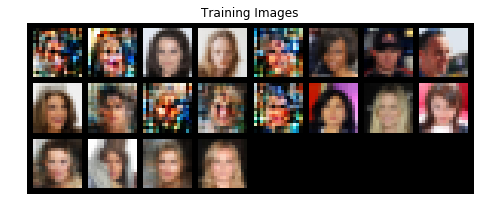

In [0]:
real_batch = next(iter(train_loader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vision_utils.make_grid(real_batch['x'][:20].to(device), padding=2, normalize=True).cpu(),(1,2,0)))

In [0]:
real_batch['y'][:20]

tensor([0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 1])

### Model

In [0]:
checkpoint = torch.load('./drive/My Drive/preD-8-best.pth')
netD.load_state_dict(checkpoint['model_state_dict'])
optimizer_D.load_state_dict(checkpoint['optimizer_state_dict'])
epoch = checkpoint['epoch']

netD.train()

Sequential(
  (0): DiscriminatorTemp(
    (model): Sequential(
      (0): Conv2d(3, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace)
    )
  )
  (1): DiscriminatorBlock(
    (model): Sequential(
      (0): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
      (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace)
      (3): Conv2d(512, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (4): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (5): LeakyReLU(negative_slope=0.2, inplace)
    )
  )
  (2): Sequential(
    (0): Discriminator(
      (model): Sequential(
        (0): Conv2d(512, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (1): BatchNorm2d(512, eps=1e-05, 

In [0]:
random.seed(seed)
torch.manual_seed(seed)
np.random.seed(seed)

In [0]:
netD = addDisLayer(netD, ndf * 2, ndf * 4)
netD

Sequential(
  (0): DiscriminatorTemp(
    (model): Sequential(
      (0): Conv2d(3, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace)
    )
  )
  (1): DiscriminatorBlock(
    (model): Sequential(
      (0): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
      (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace)
      (3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (5): LeakyReLU(negative_slope=0.2, inplace)
    )
  )
  (2): Sequential(
    (0): DiscriminatorBlock(
      (model): Sequential(
        (0): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
        (1): BatchNorm2d(512, eps=1e-05, momentu

### Loss and other parameters

In [0]:
criterion = nn.BCELoss()

In [0]:
lr = 1e-3
n_epochs = 5
optimizer_D = optim.Adam(netD.parameters(), lr=lr, betas=(0.5, 0.999))

In [0]:
D_train_losses = []
D_valid_losses = []

In [0]:
valid_loss_min = np.Inf # track change in validation loss

for epoch in range(1, n_epochs+1):

    # keep track of training and validation loss
    train_loss = 0.0
    valid_loss = 0.0
    
    # train the model #
    netD.train()
    for data in train_loader:
        img = data['x'].cuda()
        target = torch.FloatTensor(data['y'].numpy()).cuda()
        # clear the gradients of all optimized variables
        optimizer_D.zero_grad()
        # forward pass: compute predicted outputs by passing inputs to the model
        output = netD(img)
        # calculate the batch loss
        loss = criterion(output, target)
        # backward pass: compute gradient of the loss with respect to model parameters
        loss.backward()
        # perform a single optimization step (parameter update)
        optimizer_D.step()
        # update training loss
        train_loss += loss.item()*data['x'].size(0)
        
    # Validating the model
    netD.eval()
    for data in validation_loader:
        img = data['x'].cuda()
        target = torch.FloatTensor(data['y'].numpy()).cuda()
        # forward pass: compute predicted outputs by passing inputs to the model
        output = netD(img)
        # calculate the batch loss
        loss = criterion(output, target)
        # update average validation loss 
        valid_loss += loss.item()*data['x'].size(0)
    
    # calculate average losses
    train_loss = train_loss/len(train_loader.dataset)
    valid_loss = valid_loss/len(validation_loader.dataset)
        
    # print training/validation statistics 
    print('Epoch: {} \tTraining Loss: {:.6f} \tValidation Loss: {:.6f}'.format(
        epoch, train_loss, valid_loss))
    
    # save model if validation loss has decreased
    if valid_loss <= valid_loss_min:
        print('Validation loss decreased ({:.6f} --> {:.6f}).  Saving model ...'.format(
        valid_loss_min,
        valid_loss))
        torch.save({
                'epoch': epoch,
                'model_state_dict':netD.state_dict(),
                'optimizer_state_dict': optimizer_D.state_dict(),
                }, "./drive/My Drive/preD-16-best.pth")
        valid_loss_min = valid_loss

/usr/local/lib/python3.6/dist-packages/torch/nn/modules/loss.py:512: UserWarning: Using a target size (torch.Size([128])) that is different to the input size (torch.Size([128, 1, 1, 1])) is deprecated. Please ensure they have the same size.
  return F.binary_cross_entropy(input, target, weight=self.weight, reduction=self.reduction)
/usr/local/lib/python3.6/dist-packages/torch/nn/modules/loss.py:512: UserWarning: Using a target size (torch.Size([68])) that is different to the input size (torch.Size([68, 1, 1, 1])) is deprecated. Please ensure they have the same size.
  return F.binary_cross_entropy(input, target, weight=self.weight, reduction=self.reduction)
/usr/local/lib/python3.6/dist-packages/torch/nn/modules/loss.py:512: UserWarning: Using a target size (torch.Size([35])) that is different to the input size (torch.Size([35, 1, 1, 1])) is deprecated. Please ensure they have the same size.
  return F.binary_cross_entropy(input, target, weight=self.weight, reduction=self.reduction)


Epoch: 1 	Training Loss: 0.016992 	Validation Loss: 0.000094
Validation loss decreased (inf --> 0.000094).  Saving model ...
Epoch: 2 	Training Loss: 0.001833 	Validation Loss: 0.000049
Validation loss decreased (0.000094 --> 0.000049).  Saving model ...
Epoch: 3 	Training Loss: 0.007314 	Validation Loss: 0.000090
Epoch: 4 	Training Loss: 0.001049 	Validation Loss: 0.000013
Validation loss decreased (0.000049 --> 0.000013).  Saving model ...
Epoch: 5 	Training Loss: 0.000852 	Validation Loss: 0.000193


In [0]:
checkpoint = torch.load('./drive/My Drive/preD-16-best.pth')
netD.load_state_dict(checkpoint['model_state_dict'])
optimizer_D.load_state_dict(checkpoint['optimizer_state_dict'])
epoch = checkpoint['epoch']

netD.train()

Sequential(
  (0): DiscriminatorTemp(
    (model): Sequential(
      (0): Conv2d(3, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace)
    )
  )
  (1): DiscriminatorBlock(
    (model): Sequential(
      (0): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
      (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace)
      (3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (5): LeakyReLU(negative_slope=0.2, inplace)
    )
  )
  (2): Sequential(
    (0): DiscriminatorBlock(
      (model): Sequential(
        (0): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
        (1): BatchNorm2d(512, eps=1e-05, momentu

## Upscale (32x 32)

### Model

In [0]:
netG = addGenLayer(netG, ngf * 2, ngf * 1)
netG

Sequential(
  (0): Sequential(
    (0): Sequential(
      (0): Sequential(
        (0): Generator(
          (model): Sequential(
            (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
            (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
            (2): ReLU(inplace)
            (3): Conv2d(512, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            (4): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
            (5): ReLU(inplace)
          )
        )
      )
      (1): GeneratorBlock(
        (model): Sequential(
          (0): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
          (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (2): ReLU(inplace)
          (3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
          (4): BatchNorm2d(256, eps=1e-

### DataLoader

In [0]:
random.seed(seed)
torch.manual_seed(seed)
np.random.seed(seed)

In [0]:
dataset = NoiseImageDataset(root=PATH/'img_align_celeba',
                           noise_set=noise_set,
                           transforms_=[
                               transforms.Resize(image_size // 2),
                               transforms.CenterCrop(image_size // 2),
                               transforms.ToTensor(),
                               transforms.Normalize((.5,.5,.5), (.5,.5,.5)),
                           ])

dataloader = DataLoader(dataset, batch_size=b_size, 
                        shuffle=True, num_workers=0)

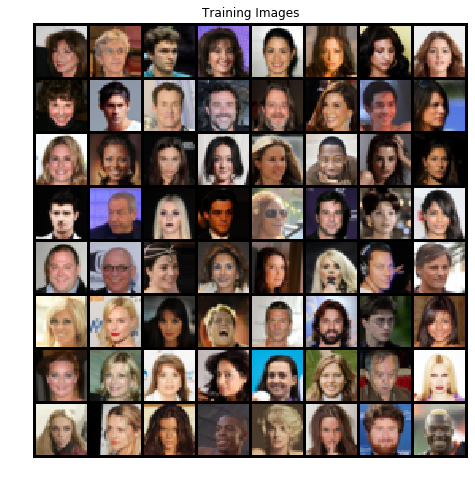

In [0]:
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vision_utils.make_grid(real_batch['y'].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

### Parameters

In [0]:
criterion = nn.L1Loss()

In [0]:
lr = 1e-3
n_epochs = 10
optimizer_G = optim.Adam(netG.parameters(), lr=lr, betas=(0.5, 0.999))
# optimizer_D = optim.Adam(netD.parameters(), lr=lr, betas=(0.5, 0.999))

### Memory Allocations

In [0]:
G_losses = []
Tensor = torch.cuda.FloatTensor
target = Tensor(b_size, 3, image_size//2, image_size//2)
# input_B = Tensor(b_size, 3, image_size//16, image_size//16)

In [0]:
target_real = Variable(Tensor(b_size).fill_(1.), requires_grad=False)
target_fake = Variable(Tensor(b_size).fill_(0.), requires_grad=False)

### Training

In [0]:
import os
import shutil

In [0]:
for e in range(0 , n_epochs):
  for i, batch in enumerate(dataloader):
    
    if(batch['y'].shape[0] != b_size):
      continue

    # Set model inputs
    target_img = Variable(target.copy_(batch['y']))
    inp = batch['x']
    
    optimizer_G.zero_grad()
    
    # L1 Loss
    fake_img = netG(inp)
    loss_G = criterion(fake_img, target_img)
    loss_G.backward()
    
    optimizer_G.step()
    
    
    # Output training stats
    if i % 50 == 0:
        print('[%d/%d][%d/%d]\tLoss_G: %.4f'
              % (e, n_epochs, i, len(dataloader),
                 loss_G.item()))

    # Save Losses for plotting later
    G_losses.append(loss_G.item())
  
  if e % 5 == 0:
    torch.save({
            'epoch': e,
            'model_state_dict':netG.state_dict(),
            'optimizer_state_dict': optimizer_G.state_dict(),
            }, "./drive/My Drive/preG-32-{}.pth".format(e))

[0/10][0/1583]	Loss_G: 0.4994
[0/10][50/1583]	Loss_G: 0.2277
[0/10][100/1583]	Loss_G: 0.2275
[0/10][150/1583]	Loss_G: 0.2352
[0/10][200/1583]	Loss_G: 0.2364
[0/10][250/1583]	Loss_G: 0.2332
[0/10][300/1583]	Loss_G: 0.2296
[0/10][350/1583]	Loss_G: 0.2377
[0/10][400/1583]	Loss_G: 0.2379
[0/10][450/1583]	Loss_G: 0.2434
[0/10][500/1583]	Loss_G: 0.2329
[0/10][550/1583]	Loss_G: 0.2376
[0/10][600/1583]	Loss_G: 0.2338
[0/10][650/1583]	Loss_G: 0.2384
[0/10][700/1583]	Loss_G: 0.2404
[0/10][750/1583]	Loss_G: 0.2322
[0/10][800/1583]	Loss_G: 0.2216
[0/10][850/1583]	Loss_G: 0.2407
[0/10][900/1583]	Loss_G: 0.2370
[0/10][950/1583]	Loss_G: 0.2318
[0/10][1000/1583]	Loss_G: 0.2316
[0/10][1050/1583]	Loss_G: 0.2334
[0/10][1100/1583]	Loss_G: 0.2434
[0/10][1150/1583]	Loss_G: 0.2398
[0/10][1200/1583]	Loss_G: 0.2401
[0/10][1250/1583]	Loss_G: 0.2348
[0/10][1300/1583]	Loss_G: 0.2306
[0/10][1350/1583]	Loss_G: 0.2295
[0/10][1400/1583]	Loss_G: 0.2363
[0/10][1450/1583]	Loss_G: 0.2430
[0/10][1500/1583]	Loss_G: 0.2360


In [0]:
torch.save({
        'epoch': e,
        'model_state_dict':netG.state_dict(),
        'optimizer_state_dict': optimizer_G.state_dict(),
        }, "./drive/My Drive/preG-32-final.pth".format(e))

In [0]:
checkpoint = torch.load('./drive/My Drive/preG-32-final.pth')
netG.load_state_dict(checkpoint['model_state_dict'])
optimizer_G.load_state_dict(checkpoint['optimizer_state_dict'])
epoch = checkpoint['epoch']

netG.train()

Sequential(
  (0): Sequential(
    (0): Sequential(
      (0): Sequential(
        (0): Generator(
          (model): Sequential(
            (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
            (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
            (2): ReLU(inplace)
            (3): Conv2d(512, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            (4): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
            (5): ReLU(inplace)
          )
        )
      )
      (1): GeneratorBlock(
        (model): Sequential(
          (0): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
          (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (2): ReLU(inplace)
          (3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
          (4): BatchNorm2d(256, eps=1e-

## 32x32 Images (Discriminator)

### Sampling Images

In [0]:
random.seed(seed)
torch.manual_seed(seed)
np.random.seed(seed)

In [0]:
# Sampling fake images
fake_samples = []
for i in range(1, d_len + 1):
  fixed_noise = noise_set[i-1]
  fake = netG(fixed_noise.unsqueeze(0)).detach().cpu().numpy()
  fake_samples.append(fake.squeeze(0))
  if i % 50000 == 0:
    print(i)

50000
100000
150000
200000


### DataLoader


In [0]:
class DiscrimDataset(Dataset):
  def __init__(self, root, fake_samples, transforms_=None):
    self.transform = transforms.Compose(transforms_)
    
    self.files = sorted(glob.glob(os.path.join(root) + '/*.*'))
    self.fake_samples = fake_samples
    self.len = len(fake_samples)
    
  def __getitem__(self, index):
    rand = np.random.random_sample()
    if rand >= 0.5:
      item = self.transform(Image.open(self.files[index % self.len]))
      return {'x': item, 'y': 1}
    else:
      item = torch.from_numpy(self.fake_samples[index % self.len])
      return {'x': item, 'y': 0}
    
  
  def __len__(self):
    return self.len

In [0]:
dataset = DiscrimDataset(root=PATH/'img_align_celeba',
                           fake_samples=fake_samples,
                           transforms_=[
                               transforms.Resize(image_size // 2),
                               transforms.CenterCrop(image_size // 2),
                               transforms.ToTensor(),
                               transforms.Normalize((.5,.5,.5), (.5,.5,.5)),
                           ])

In [0]:
random.seed(seed)
torch.manual_seed(seed)
np.random.seed(seed)

In [0]:
# train validation split
validation_split = 0.1

dataset_len = len(dataset)
indices = list(range(dataset_len))

# Randomly splitting indices:
val_len = int(np.floor(validation_split * dataset_len))
validation_idx = np.random.choice(indices, size=val_len, replace=False)
train_idx = list(set(indices) - set(validation_idx))

# Samplers
train_sampler = SubsetRandomSampler(train_idx)
validation_sampler = SubsetRandomSampler(validation_idx)

# DataLoader
train_loader = DataLoader(dataset, sampler=train_sampler, batch_size=b_size)
validation_loader = DataLoader(dataset, sampler=validation_sampler, batch_size=b_size)
data_loaders = {"train": train_loader, "val": validation_loader}
data_lengths = {"train": len(train_idx), "val": val_len}

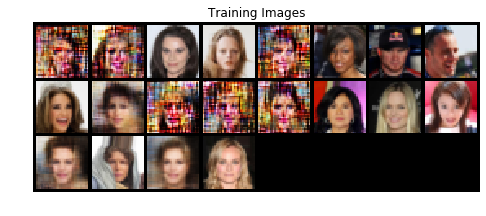

In [0]:
real_batch = next(iter(train_loader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vision_utils.make_grid(real_batch['x'][:20].to(device), padding=2, normalize=True).cpu(),(1,2,0)))

In [0]:
real_batch['y'][:20]

tensor([0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 1])

### Model

In [0]:
checkpoint = torch.load('./drive/My Drive/preD-16-best.pth')
netD.load_state_dict(checkpoint['model_state_dict'])
optimizer_D.load_state_dict(checkpoint['optimizer_state_dict'])
epoch = checkpoint['epoch']

netD.train()

Sequential(
  (0): DiscriminatorTemp(
    (model): Sequential(
      (0): Conv2d(3, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace)
    )
  )
  (1): DiscriminatorBlock(
    (model): Sequential(
      (0): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
      (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace)
      (3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (5): LeakyReLU(negative_slope=0.2, inplace)
    )
  )
  (2): Sequential(
    (0): DiscriminatorBlock(
      (model): Sequential(
        (0): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
        (1): BatchNorm2d(512, eps=1e-05, momentu

In [0]:
random.seed(seed)
torch.manual_seed(seed)
np.random.seed(seed)

In [0]:
netD = addDisLayer(netD, ndf * 1, ndf * 2)
netD

Sequential(
  (0): DiscriminatorTemp(
    (model): Sequential(
      (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace)
    )
  )
  (1): DiscriminatorBlock(
    (model): Sequential(
      (0): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
      (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace)
      (3): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (4): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (5): LeakyReLU(negative_slope=0.2, inplace)
    )
  )
  (2): Sequential(
    (0): DiscriminatorBlock(
      (model): Sequential(
        (0): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
        (1): BatchNorm2d(256, eps=1e-05, momentum=0

### Loss and other parameters

In [0]:
criterion = nn.BCELoss()

In [0]:
lr = 1e-3
n_epochs = 5
optimizer_D = optim.Adam(netD.parameters(), lr=lr, betas=(0.5, 0.999))

In [0]:
D_train_losses = []
D_valid_losses = []

In [0]:
valid_loss_min = np.Inf # track change in validation loss

for epoch in range(1, n_epochs+1):

    # keep track of training and validation loss
    train_loss = 0.0
    valid_loss = 0.0
    
    # train the model #
    netD.train()
    for data in train_loader:
        img = data['x'].cuda()
        target = torch.FloatTensor(data['y'].numpy()).cuda()
        # clear the gradients of all optimized variables
        optimizer_D.zero_grad()
        # forward pass: compute predicted outputs by passing inputs to the model
        output = netD(img)
        # calculate the batch loss
        loss = criterion(output, target)
        # backward pass: compute gradient of the loss with respect to model parameters
        loss.backward()
        # perform a single optimization step (parameter update)
        optimizer_D.step()
        # update training loss
        train_loss += loss.item()*data['x'].size(0)
        
    # Validating the model
    netD.eval()
    for data in validation_loader:
        img = data['x'].cuda()
        target = torch.FloatTensor(data['y'].numpy()).cuda()
        # forward pass: compute predicted outputs by passing inputs to the model
        output = netD(img)
        # calculate the batch loss
        loss = criterion(output, target)
        # update average validation loss 
        valid_loss += loss.item()*data['x'].size(0)
    
    # calculate average losses
    train_loss = train_loss/len(train_loader.dataset)
    valid_loss = valid_loss/len(validation_loader.dataset)
        
    # print training/validation statistics 
    print('Epoch: {} \tTraining Loss: {:.6f} \tValidation Loss: {:.6f}'.format(
        epoch, train_loss, valid_loss))
    
    # save model if validation loss has decreased
    if valid_loss <= valid_loss_min:
        print('Validation loss decreased ({:.6f} --> {:.6f}).  Saving model ...'.format(
        valid_loss_min,
        valid_loss))
        torch.save({
                'epoch': epoch,
                'model_state_dict':netD.state_dict(),
                'optimizer_state_dict': optimizer_D.state_dict(),
                }, "./drive/My Drive/preD-32-best.pth")
        valid_loss_min = valid_loss

/usr/local/lib/python3.6/dist-packages/torch/nn/modules/loss.py:512: UserWarning: Using a target size (torch.Size([128])) that is different to the input size (torch.Size([128, 1, 1, 1])) is deprecated. Please ensure they have the same size.
  return F.binary_cross_entropy(input, target, weight=self.weight, reduction=self.reduction)
/usr/local/lib/python3.6/dist-packages/torch/nn/modules/loss.py:512: UserWarning: Using a target size (torch.Size([68])) that is different to the input size (torch.Size([68, 1, 1, 1])) is deprecated. Please ensure they have the same size.
  return F.binary_cross_entropy(input, target, weight=self.weight, reduction=self.reduction)
/usr/local/lib/python3.6/dist-packages/torch/nn/modules/loss.py:512: UserWarning: Using a target size (torch.Size([35])) that is different to the input size (torch.Size([35, 1, 1, 1])) is deprecated. Please ensure they have the same size.
  return F.binary_cross_entropy(input, target, weight=self.weight, reduction=self.reduction)


Epoch: 1 	Training Loss: 0.012031 	Validation Loss: 0.000057
Validation loss decreased (inf --> 0.000057).  Saving model ...
Epoch: 2 	Training Loss: 0.001898 	Validation Loss: 0.001416
Epoch: 3 	Training Loss: 0.000986 	Validation Loss: 0.000023
Validation loss decreased (0.000057 --> 0.000023).  Saving model ...
Epoch: 4 	Training Loss: 0.001602 	Validation Loss: 0.000003
Validation loss decreased (0.000023 --> 0.000003).  Saving model ...
Epoch: 5 	Training Loss: 0.000377 	Validation Loss: 0.000002
Validation loss decreased (0.000003 --> 0.000002).  Saving model ...


In [0]:
checkpoint = torch.load('./drive/My Drive/preD-32-best.pth')
netD.load_state_dict(checkpoint['model_state_dict'])
optimizer_D.load_state_dict(checkpoint['optimizer_state_dict'])
epoch = checkpoint['epoch']

netD.train()

Sequential(
  (0): DiscriminatorTemp(
    (model): Sequential(
      (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace)
    )
  )
  (1): DiscriminatorBlock(
    (model): Sequential(
      (0): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
      (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace)
      (3): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (4): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (5): LeakyReLU(negative_slope=0.2, inplace)
    )
  )
  (2): Sequential(
    (0): DiscriminatorBlock(
      (model): Sequential(
        (0): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
        (1): BatchNorm2d(256, eps=1e-05, momentum=0

## Upscale (64x 64)

### Model

In [0]:
netG = addGenLayer(netG, ngf * 1, ngf * 1)
netG

Sequential(
  (0): Sequential(
    (0): Sequential(
      (0): Sequential(
        (0): Sequential(
          (0): Generator(
            (model): Sequential(
              (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
              (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
              (2): ReLU(inplace)
              (3): Conv2d(512, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (4): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
              (5): ReLU(inplace)
            )
          )
        )
        (1): GeneratorBlock(
          (model): Sequential(
            (0): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
            (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
            (2): ReLU(inplace)
            (3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 

### DataLoader

In [0]:
random.seed(seed)
torch.manual_seed(seed)
np.random.seed(seed)

In [0]:
dataset = NoiseImageDataset(root=PATH/'img_align_celeba',
                           noise_set=noise_set,
                           transforms_=[
                               transforms.Resize(image_size // 1),
                               transforms.CenterCrop(image_size // 1),
                               transforms.ToTensor(),
                               transforms.Normalize((.5,.5,.5), (.5,.5,.5)),
                           ])

dataloader = DataLoader(dataset, batch_size=b_size, 
                        shuffle=True, num_workers=0)

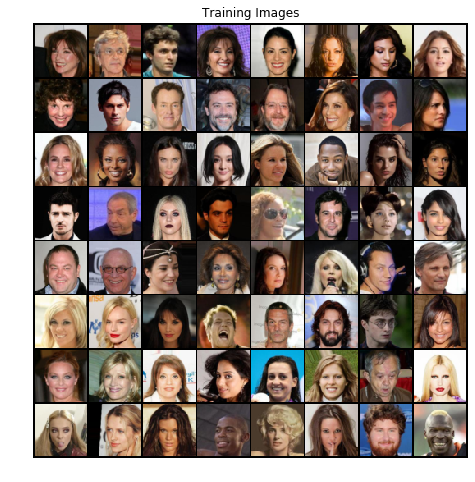

In [0]:
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vision_utils.make_grid(real_batch['y'].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

### Parameters

In [0]:
criterion = nn.L1Loss()

In [0]:
lr = 1e-3
n_epochs = 10
optimizer_G = optim.Adam(netG.parameters(), lr=lr, betas=(0.5, 0.999))
# optimizer_D = optim.Adam(netD.parameters(), lr=lr, betas=(0.5, 0.999))

### Memory Allocations

In [0]:
G_losses = []
Tensor = torch.cuda.FloatTensor
target = Tensor(b_size, 3, image_size//1, image_size//1)
# input_B = Tensor(b_size, 3, image_size//16, image_size//16)

In [0]:
target_real = Variable(Tensor(b_size).fill_(1.), requires_grad=False)
target_fake = Variable(Tensor(b_size).fill_(0.), requires_grad=False)

### Training

In [0]:
import os
import shutil

In [0]:
for e in range(0 , n_epochs):
  for i, batch in enumerate(dataloader):
    
    if(batch['y'].shape[0] != b_size):
      continue

    # Set model inputs
    target_img = Variable(target.copy_(batch['y']))
    inp = batch['x']
    
    optimizer_G.zero_grad()
    
    # L1 Loss
    fake_img = netG(inp)
    loss_G = criterion(fake_img, target_img)
    loss_G.backward()
    
    optimizer_G.step()
    
    
    # Output training stats
    if i % 50 == 0:
        print('[%d/%d][%d/%d]\tLoss_G: %.4f'
              % (e, n_epochs, i, len(dataloader),
                 loss_G.item()))

    # Save Losses for plotting later
    G_losses.append(loss_G.item())
  
  if e % 5 == 0:
    torch.save({
            'epoch': e,
            'model_state_dict':netG.state_dict(),
            'optimizer_state_dict': optimizer_G.state_dict(),
            }, "./drive/My Drive/preG-64-{}.pth".format(e))

[0/10][0/1583]	Loss_G: 0.5610
[0/10][50/1583]	Loss_G: 0.2255
[0/10][100/1583]	Loss_G: 0.2281
[0/10][150/1583]	Loss_G: 0.2358
[0/10][200/1583]	Loss_G: 0.2362
[0/10][250/1583]	Loss_G: 0.2318
[0/10][300/1583]	Loss_G: 0.2302
[0/10][350/1583]	Loss_G: 0.2384
[0/10][400/1583]	Loss_G: 0.2386
[0/10][450/1583]	Loss_G: 0.2445
[0/10][500/1583]	Loss_G: 0.2329
[0/10][550/1583]	Loss_G: 0.2410
[0/10][600/1583]	Loss_G: 0.2375
[0/10][650/1583]	Loss_G: 0.2409
[0/10][700/1583]	Loss_G: 0.2428
[0/10][750/1583]	Loss_G: 0.2332
[0/10][800/1583]	Loss_G: 0.2231
[0/10][850/1583]	Loss_G: 0.2401
[0/10][900/1583]	Loss_G: 0.2383
[0/10][950/1583]	Loss_G: 0.2322
[0/10][1000/1583]	Loss_G: 0.2325
[0/10][1050/1583]	Loss_G: 0.2358
[0/10][1100/1583]	Loss_G: 0.2452
[0/10][1150/1583]	Loss_G: 0.2402
[0/10][1200/1583]	Loss_G: 0.2429
[0/10][1250/1583]	Loss_G: 0.2356
[0/10][1300/1583]	Loss_G: 0.2310
[0/10][1350/1583]	Loss_G: 0.2319
[0/10][1400/1583]	Loss_G: 0.2365
[0/10][1450/1583]	Loss_G: 0.2407
[0/10][1500/1583]	Loss_G: 0.2382


In [0]:
torch.save({
        'epoch': e,
        'model_state_dict':netG.state_dict(),
        'optimizer_state_dict': optimizer_G.state_dict(),
        }, "./drive/My Drive/preG-64-final.pth".format(e))

In [0]:
checkpoint = torch.load('./drive/My Drive/preG-64-final.pth')
netG.load_state_dict(checkpoint['model_state_dict'])
optimizer_G.load_state_dict(checkpoint['optimizer_state_dict'])
epoch = checkpoint['epoch']

netG.eval()

Sequential(
  (0): Sequential(
    (0): Sequential(
      (0): Sequential(
        (0): Sequential(
          (0): Generator(
            (model): Sequential(
              (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
              (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
              (2): ReLU(inplace)
              (3): Conv2d(512, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (4): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
              (5): ReLU(inplace)
            )
          )
        )
        (1): GeneratorBlock(
          (model): Sequential(
            (0): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
            (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
            (2): ReLU(inplace)
            (3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 

## 64x64 Images (Discriminator)

### Sampling Images

In [0]:
random.seed(seed)
torch.manual_seed(seed)
np.random.seed(seed)

In [0]:
# Sampling fake images
fake_samples = []
for i in range(1, d_len + 1):
  fixed_noise = noise_set[i-1]
  fake = netG(fixed_noise.unsqueeze(0)).detach().cpu().numpy()
  fake_samples.append(fake.squeeze(0))
  if i % 50000 == 0:
    print(i)

50000
100000


KeyboardInterrupt: ignored

### DataLoader


In [0]:
l = len(fake_samples)
l

136158

In [0]:
class DiscrimDataset(Dataset):
  def __init__(self, root, fake_samples, transforms_=None):
    self.transform = transforms.Compose(transforms_)
    
    self.files = sorted(glob.glob(os.path.join(root) + '/*.*'))
    self.fake_samples = fake_samples
    self.l = len(fake_samples)
    self.len = len(self.files)
    
  def __getitem__(self, index):
    rand = np.random.random_sample()
    if rand >= 0.5:
      item = self.transform(Image.open(self.files[index % self.len]))
      return {'x': item, 'y': 1}
    else:
      item = torch.from_numpy(self.fake_samples[index % self.l])
      return {'x': item, 'y': 0}
    
  
  def __len__(self):
    return self.len

In [0]:
dataset = DiscrimDataset(root=PATH/'img_align_celeba',
                           fake_samples=fake_samples,
                           transforms_=[
                               transforms.Resize(image_size // 1),
                               transforms.CenterCrop(image_size // 1),
                               transforms.ToTensor(),
                               transforms.Normalize((.5,.5,.5), (.5,.5,.5)),
                           ])

In [0]:
random.seed(seed)
torch.manual_seed(seed)
np.random.seed(seed)

In [0]:
# train validation split
validation_split = 0.1

dataset_len = len(dataset)
indices = list(range(dataset_len))

# Randomly splitting indices:
val_len = int(np.floor(validation_split * dataset_len))
validation_idx = np.random.choice(indices, size=val_len, replace=False)
train_idx = list(set(indices) - set(validation_idx))

# Samplers
train_sampler = SubsetRandomSampler(train_idx)
validation_sampler = SubsetRandomSampler(validation_idx)

# DataLoader
train_loader = DataLoader(dataset, sampler=train_sampler, batch_size=b_size)
validation_loader = DataLoader(dataset, sampler=validation_sampler, batch_size=b_size)
data_loaders = {"train": train_loader, "val": validation_loader}
data_lengths = {"train": len(train_idx), "val": val_len}

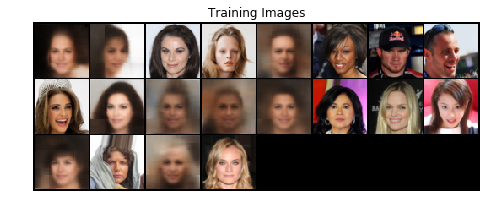

In [0]:
real_batch = next(iter(train_loader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vision_utils.make_grid(real_batch['x'][:20].to(device), padding=2, normalize=True).cpu(),(1,2,0)))

In [0]:
real_batch['y'][:20]

tensor([0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 1])

### Model

In [0]:
checkpoint = torch.load('./drive/My Drive/preD-32-best.pth')
netD.load_state_dict(checkpoint['model_state_dict'])
optimizer_D.load_state_dict(checkpoint['optimizer_state_dict'])
epoch = checkpoint['epoch']

netD.train()

Sequential(
  (0): DiscriminatorTemp(
    (model): Sequential(
      (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace)
    )
  )
  (1): DiscriminatorBlock(
    (model): Sequential(
      (0): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
      (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace)
      (3): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (4): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (5): LeakyReLU(negative_slope=0.2, inplace)
    )
  )
  (2): Sequential(
    (0): DiscriminatorBlock(
      (model): Sequential(
        (0): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
        (1): BatchNorm2d(256, eps=1e-05, momentum=0

In [0]:
random.seed(seed)
torch.manual_seed(seed)
np.random.seed(seed)

In [0]:
netD = addDisLayer(netD, ndf // 2, ndf * 1)
netD

Sequential(
  (0): DiscriminatorTemp(
    (model): Sequential(
      (0): Conv2d(3, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace)
    )
  )
  (1): DiscriminatorBlock(
    (model): Sequential(
      (0): Conv2d(32, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
      (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace)
      (3): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (4): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (5): LeakyReLU(negative_slope=0.2, inplace)
    )
  )
  (2): Sequential(
    (0): DiscriminatorBlock(
      (model): Sequential(
        (0): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
        (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, af

### Loss and other parameters

In [0]:
criterion = nn.BCELoss()

In [0]:
lr = 1e-3
n_epochs = 20
optimizer_D = optim.Adam(netD.parameters(), lr=lr, betas=(0.5, 0.999))

In [0]:
D_train_losses = []
D_valid_losses = []

In [0]:
valid_loss_min = np.Inf # track change in validation loss

for epoch in range(1, n_epochs+1):

    # keep track of training and validation loss
    train_loss = 0.0
    valid_loss = 0.0
    
    # train the model #
    netD.train()
    for data in train_loader:
        img = data['x'].cuda()
        target = torch.FloatTensor(data['y'].numpy()).cuda()
        # clear the gradients of all optimized variables
        optimizer_D.zero_grad()
        # forward pass: compute predicted outputs by passing inputs to the model
        output = netD(img)
        # calculate the batch loss
        loss = 0.5 * ((output - target)**2).mean().view(1)
        # backward pass: compute gradient of the loss with respect to model parameters
        loss.backward()
        # perform a single optimization step (parameter update)
        optimizer_D.step()
        # update training loss
        train_loss += loss.item()*data['x'].size(0)
        
    # Validating the model
    netD.eval()
    for data in validation_loader:
        img = data['x'].cuda()
        target = torch.FloatTensor(data['y'].numpy()).cuda()
        # forward pass: compute predicted outputs by passing inputs to the model
        output = netD(img)
        # calculate the batch loss
        loss = 0.5 * ((output - target)**2).mean().view(1)
        # update average validation loss 
        valid_loss += loss.item()*data['x'].size(0)
    
    # calculate average losses
    train_loss = train_loss/len(train_loader.dataset)
    valid_loss = valid_loss/len(validation_loader.dataset)
        
    # print training/validation statistics 
    print('Epoch: {} \tTraining Loss: {:.6f} \tValidation Loss: {:.6f}'.format(
        epoch, train_loss, valid_loss))
    
    # save model if validation loss has decreased
    if valid_loss <= valid_loss_min:
        print('Validation loss decreased ({:.6f} --> {:.6f}).  Saving model ...'.format(
        valid_loss_min,
        valid_loss))
        torch.save({
                'epoch': epoch,
                'model_state_dict':netD.state_dict(),
                'optimizer_state_dict': optimizer_D.state_dict(),
                }, "./drive/My Drive/preD-64-best.pth")
        valid_loss_min = valid_loss

Epoch: 1 	Training Loss: 0.798585 	Validation Loss: 0.090008
Validation loss decreased (inf --> 0.090008).  Saving model ...
Epoch: 2 	Training Loss: 0.803906 	Validation Loss: 0.089249
Validation loss decreased (0.090008 --> 0.089249).  Saving model ...
Epoch: 3 	Training Loss: 0.800114 	Validation Loss: 0.089213
Validation loss decreased (0.089249 --> 0.089213).  Saving model ...
Epoch: 4 	Training Loss: 0.800433 	Validation Loss: 0.089711
Epoch: 5 	Training Loss: 0.800651 	Validation Loss: 0.087351
Validation loss decreased (0.089213 --> 0.087351).  Saving model ...
Epoch: 6 	Training Loss: 0.800465 	Validation Loss: 0.088288
Epoch: 7 	Training Loss: 0.797714 	Validation Loss: 0.088963
Epoch: 8 	Training Loss: 0.798540 	Validation Loss: 0.087807
Epoch: 9 	Training Loss: 0.800375 	Validation Loss: 0.089248
Epoch: 10 	Training Loss: 0.795230 	Validation Loss: 0.088534
Epoch: 11 	Training Loss: 0.799233 	Validation Loss: 0.087972
Epoch: 12 	Training Loss: 0.797212 	Validation Loss: 0.0

In [0]:
checkpoint = torch.load('./drive/My Drive/preD-64-best.pth')
netD.load_state_dict(checkpoint['model_state_dict'])
optimizer_D.load_state_dict(checkpoint['optimizer_state_dict'])
epoch = checkpoint['epoch']

netD.train()

Critic(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
  )
)

In [0]:
# Sampling fake images
fake_samples = []

# GAN Training

## DataLoader

In [0]:
dataset = dset.ImageFolder(root=PATH,
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((.5,.5,.5), (.5,.5,.5)),
                           ]))
  
dataloader = DataLoader(dataset, batch_size=b_size, 
                        shuffle=True, num_workers=workers)

In [0]:
random.seed(seed)
torch.manual_seed(seed)
np.random.seed(seed)

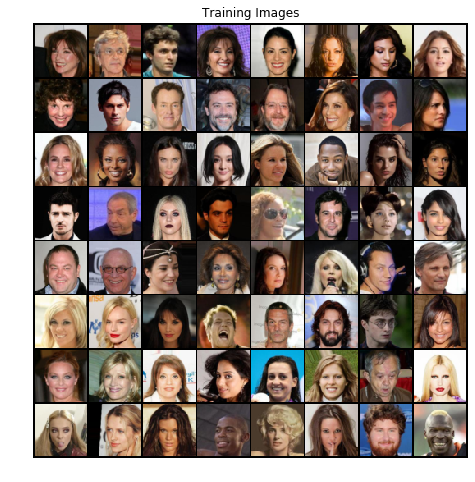

In [0]:
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vision_utils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

## Model

## Params and LR

In [0]:
random.seed(seed)
torch.manual_seed(seed)
np.random.seed(seed)

In [0]:
def get_infinite_batches(data_loader):
  while True:
      for i, (images, _) in enumerate(data_loader):
          yield images

In [0]:
fixed_noise_1 = torch.randn(64, nz, 1, 1, device=device)

real_label = 1
fake_label = 0 

In [0]:
lr_G = 4e-4
lr_D = 3e-4
optimizer_D = optim.Adam(netD.parameters(), lr=lr_D, betas=(0.5, 0.999))
optimizer_G = optim.Adam(netG.parameters(), lr=lr_G, betas=(0.5, 0.999))

In [0]:
b_size = 128

max_iters = 60000
weight_clip = 0.01
gen_iters = 2
crit_iters = 1

# Lists to keep track of progress
img_list = []
G_losses = []
C_losses_fake = []
C_losses_real = []
C_losses = []
diff_G_loss = []
diff_C_loss = []
real_C_res = np.ndarray(max_iters * b_size + 1, dtype=np.float16)
fake_C_res = np.ndarray(max_iters * b_size + 1, dtype=np.float16)

one = torch.FloatTensor([1])
mone = one * -1
one = one.cuda()
m_one = mone.cuda()

In [0]:
Tensor = torch.cuda.FloatTensor
target_real = Variable(Tensor(b_size).fill_(1.), requires_grad=False)
target_fake = Variable(Tensor(b_size).fill_(0.), requires_grad=False)

In [0]:
data = get_infinite_batches(dataloader)

In [0]:
checkpoint = torch.load('./drive/My Drive/netD-GAN-40000.pth')
netD.load_state_dict(checkpoint['model_state_dict'])
optimizer_D.load_state_dict(checkpoint['optimizer_state_dict'])
epoch = checkpoint['epoch']

netD.train()

checkpoint = torch.load('./drive/My Drive/netG-GAN-40000.pth')
netG.load_state_dict(checkpoint['model_state_dict'])
optimizer_G.load_state_dict(checkpoint['optimizer_state_dict'])
epoch = checkpoint['epoch']

netD.train()

Critic(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
  )
)

In [0]:
netG.train()
netD.train()

Critic(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
  )
)

[10/60000]	Loss_C: 0.1736	Loss_C_fake: 0.1437	Loss_C_real: 0.0299	Loss_G: 0.9602	
[20/60000]	Loss_C: 0.1417	Loss_C_fake: 0.0705	Loss_C_real: 0.0712	Loss_G: 0.3782	
[30/60000]	Loss_C: 0.0991	Loss_C_fake: 0.0416	Loss_C_real: 0.0575	Loss_G: 0.3874	
[40/60000]	Loss_C: 0.1017	Loss_C_fake: 0.0372	Loss_C_real: 0.0645	Loss_G: 0.2716	
[50/60000]	Loss_C: 0.1910	Loss_C_fake: 0.1416	Loss_C_real: 0.0494	Loss_G: 0.7335	
[60/60000]	Loss_C: 0.1190	Loss_C_fake: 0.0331	Loss_C_real: 0.0859	Loss_G: 0.3263	
[70/60000]	Loss_C: 0.1033	Loss_C_fake: 0.0497	Loss_C_real: 0.0536	Loss_G: 0.3235	
[80/60000]	Loss_C: 0.1331	Loss_C_fake: 0.0836	Loss_C_real: 0.0495	Loss_G: 0.5188	
[90/60000]	Loss_C: 0.1874	Loss_C_fake: 0.1573	Loss_C_real: 0.0301	Loss_G: 0.5874	
[100/60000]	Loss_C: 0.1343	Loss_C_fake: 0.1098	Loss_C_real: 0.0246	Loss_G: 0.4439	
[110/60000]	Loss_C: 0.1505	Loss_C_fake: 0.0226	Loss_C_real: 0.1280	Loss_G: 0.2659	
[120/60000]	Loss_C: 0.1125	Loss_C_fake: 0.0322	Loss_C_real: 0.0803	Loss_G: 0.2076	
[130/60000]	L

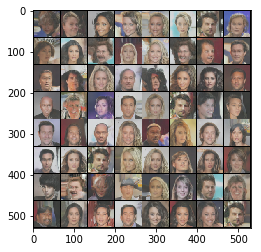

In [0]:
for i in range(1, max_iters + 1):
  
  # Since, Critic will be updated first.
  for p in netD.parameters():
    p.requires_grad = True
    
  C_loss = 0.
  for j in range(1, crit_iters + 1):
    # Update Critic network.
      
    netD.zero_grad()
        
    # Sample data from real distribution
    real_data = next(data).cuda()
    
    # Sample data from fake distribution
    noise = torch.randn(b_size, nz, 1, 1, device=device)
    fake_data = netG(noise) 
    
    # Getting the outputs of Critic
    C_real = netD(real_data)
    C_fake = netD(fake_data.detach()) # To remove it from the graph
    
    # Finding the errors
    C_loss_real = 0.5 * ((C_real - 1.0)**2).mean().view(1) # mean along rows
    C_loss_real.backward()
    
    C_loss_fake = 0.5 * ((C_fake - 0.0)**2).mean().view(1)
    C_loss_fake.backward()
    
    
    C_loss = C_loss_fake + C_loss_real # -V(D,G)
#     Wasserstein_D = -(C_loss_fake / (1 - alpha(i, max_iters, 0.5))  + C_loss_real)
    optimizer_D.step()
    
    # Clip the weights of Critic network
#     for p in netC.parameters():
#       p.data.clamp_(-weight_clip, weight_clip)
      
    # Getting real_critic_results
#     if (j % crit_iters == (crit_iters - 1)):
#       if len(real_data) == b_size:
#         for k in range(b_size):
#           real_C_res[b_size * i + k] = C_real[k]
#       else:
#         real_data1 = next(data).cuda()
#         C_real1 = netC(real_data1)
#         for k in range(b_size):
#           real_C_res[b_size * i + k] = C_real1[k]
  
  G_loss = 0.    
  # Update Generator network.
  for p in netD.parameters():
     p.requires_grad = False  # to avoid computation

  for j in range(1, gen_iters + 1):
    # Update Generator network.
    netG.zero_grad()

    # Sample data from fake distribution
    noise = torch.randn(b_size, nz, 1, 1, device=device)
    fake_data = netG(noise)

    # Finding the error
    C_G_noise = netD(fake_data)
    G_loss = 0.5 * ((C_G_noise - 1.0)**2).mean().view(1)
    G_loss.backward()
    G_cost = G_loss
    optimizer_G.step()
    
    # Getting fake_critic_results
#     for k in range(b_size):
#         fake_C_res[b_size * i + k] = C_G_noise[k]
    
    
    
  # Display Results
  if i % 10 == 0:
    print('[%d/%d]\tLoss_C: %.4f\tLoss_C_fake: %.4f\tLoss_C_real: %.4f\tLoss_G: %.4f\t'
        % (i, max_iters, C_loss.item(), C_loss_fake.item(), C_loss_real.item(), G_loss.item()))

  # Save Losses for plotting later
  G_losses.append(G_loss.item())
  C_losses.append(C_loss.item())  
  C_losses_fake.append(C_loss_fake.item())
  C_losses_real.append(C_loss_real.item())
  
#   if (i > 1):
#     diff_G_loss.append(G_losses[i-1] - G_losses[i-2])
#     diff_C_loss.append(C_losses[i-1] - C_losses[i-2])

  # Display images
  # Check how the generator is doing by saving G's output on fixed_noise
  if (i % 250 == 0):
    with torch.no_grad():
       fake = netG(fixed_noise_1).detach().cpu()
    img_list.append(vision_utils.make_grid(fake, padding=2, normalize=True))
    plt.imshow(np.transpose(vision_utils.make_grid(img_list[-1].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))
    
  if i % 5000 == 0:
    torch.save({
            'epoch': i,
            'model_state_dict':netD.state_dict(),
            'optimizer_state_dict': optimizer_D.state_dict(),
            }, "./drive/My Drive/netD-GAN-{}.pth".format(i))
    
    torch.save({
            'epoch': i,
            'model_state_dict':netG.state_dict(),
            'optimizer_state_dict': optimizer_G.state_dict(),
            }, "./drive/My Drive/netG-GAN-{}.pth".format(i))

In [0]:
import matplotlib.animation as animation
from IPython.display import HTML

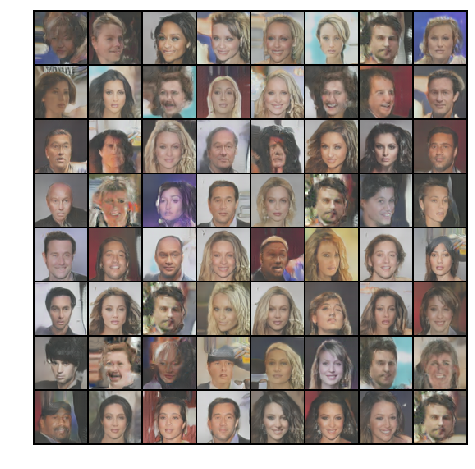

In [0]:
#%%capture
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list[-20:]]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

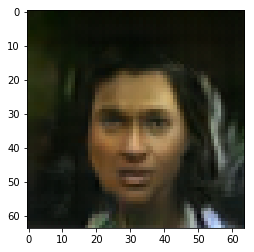

In [0]:
netG.eval()
# netG.train()
# Sampling fake images

fixed_noise = noise_set[234]
fake = netG(fixed_noise.unsqueeze(0)).detach().cpu().numpy()
plt.imshow(np.transpose(vision_utils.make_grid(torch.from_numpy(fake).to(device), padding=2, normalize=True).cpu(),(1,2,0)))

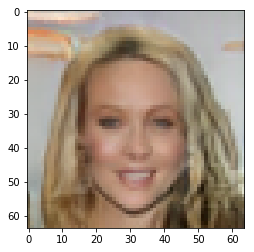

In [0]:
netG.eval()
# netG.train()
# Sampling fake images

fixed_noise = noise_set[8735]
fake = netG(fixed_noise.unsqueeze(0)).detach().cpu().numpy()
plt.imshow(np.transpose(vision_utils.make_grid(torch.from_numpy(fake).to(device), padding=2, normalize=True).cpu(),(1,2,0)))

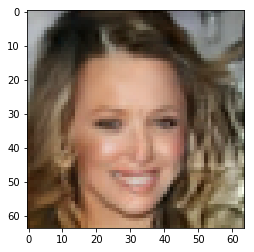

In [0]:
netG.eval()
# netG.train()
# Sampling fake images

fixed_noise = noise_set[785]
fake = netG(fixed_noise.unsqueeze(0)).detach().cpu().numpy()
plt.imshow(np.transpose(vision_utils.make_grid(torch.from_numpy(fake).to(device), padding=2, normalize=True).cpu(),(1,2,0)))

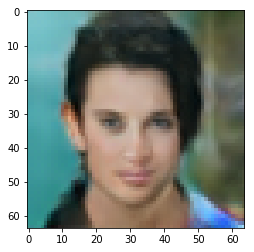

In [0]:
netG.eval()
# netG.train()
# Sampling fake images

fixed_noise = noise_set[11111]
fake = netG(fixed_noise.unsqueeze(0)).detach().cpu().numpy()
plt.imshow(np.transpose(vision_utils.make_grid(torch.from_numpy(fake).to(device), padding=2, normalize=True).cpu(),(1,2,0)))

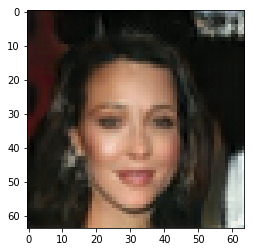

In [0]:
netG.eval()
# netG.train()
# Sampling fake images

fixed_noise = noise_set[200000]
fake = netG(fixed_noise.unsqueeze(0)).detach().cpu().numpy()
plt.imshow(np.transpose(vision_utils.make_grid(torch.from_numpy(fake).to(device), padding=2, normalize=True).cpu(),(1,2,0)))

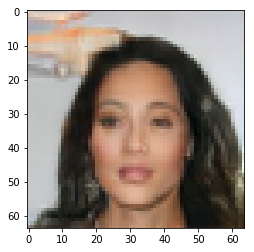

In [0]:
netG.eval()
# netG.train()
# Sampling fake images

fixed_noise = noise_set[78500]
fake = netG(fixed_noise.unsqueeze(0)).detach().cpu().numpy()
plt.imshow(np.transpose(vision_utils.make_grid(torch.from_numpy(fake).to(device), padding=2, normalize=True).cpu(),(1,2,0)))

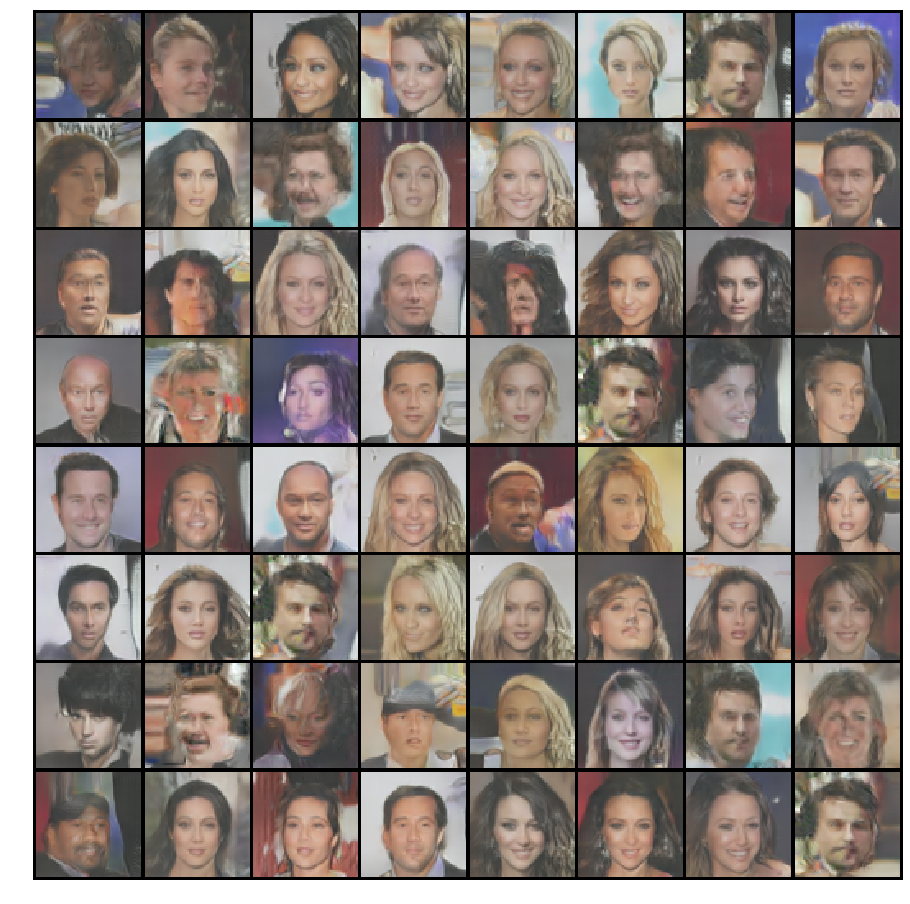

In [0]:
#%%capture
fig = plt.figure(figsize=(16,16))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list[-5:]]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

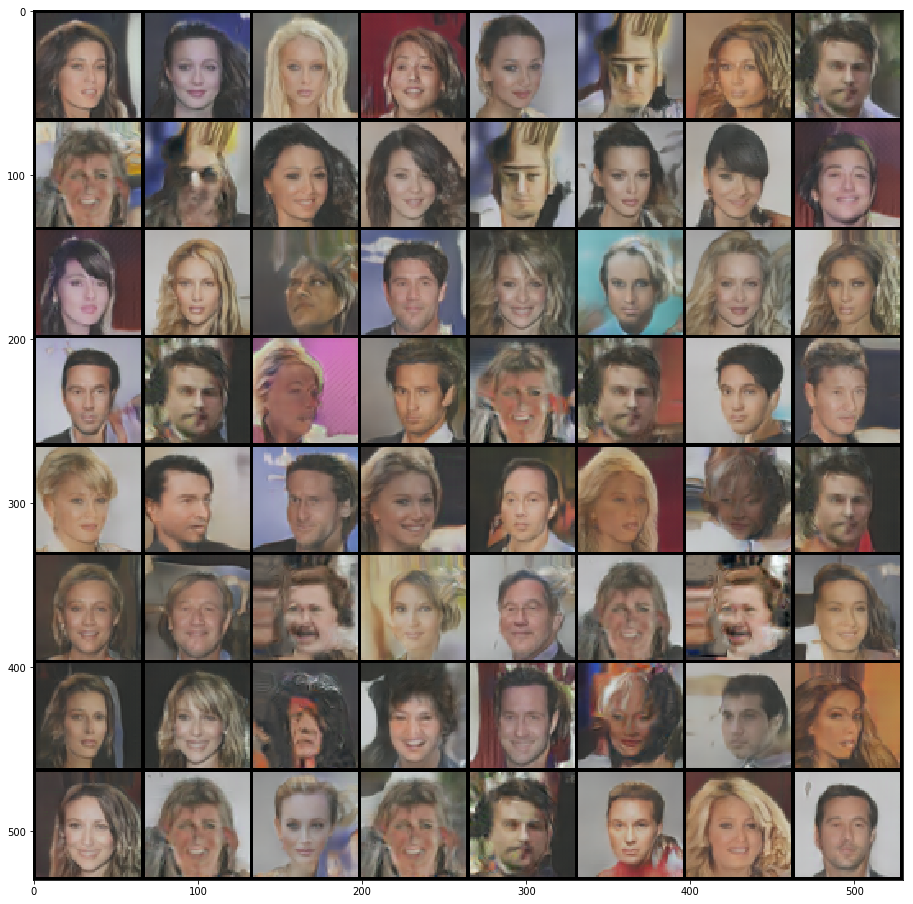

In [0]:
fixed_noise_1 = torch.randn(64, nz, 1, 1, device=device)
fig = plt.figure(figsize=(16,16))
fake = netG(fixed_noise_1).detach().cpu()
plt.imshow(np.transpose(vision_utils.make_grid(fake.to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

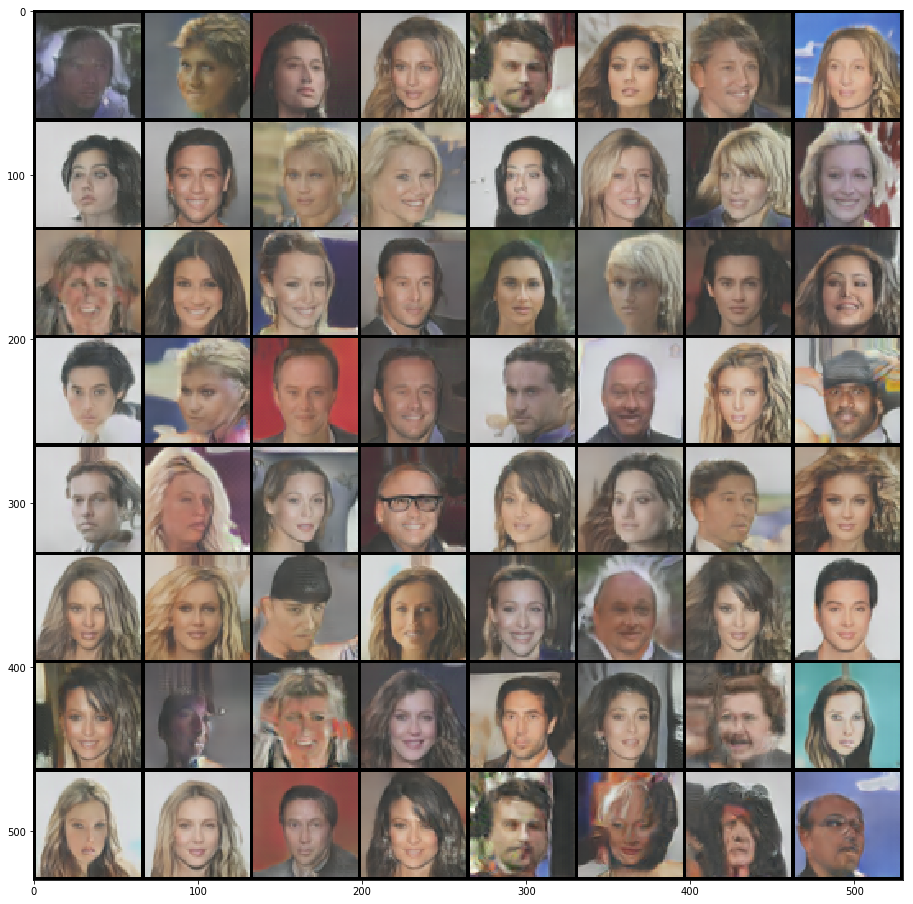

In [0]:
fixed_noise_1 = torch.randn(64, nz, 1, 1, device=device)
fig = plt.figure(figsize=(16,16))
fake = netG(fixed_noise_1).detach().cpu()
plt.imshow(np.transpose(vision_utils.make_grid(fake.to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

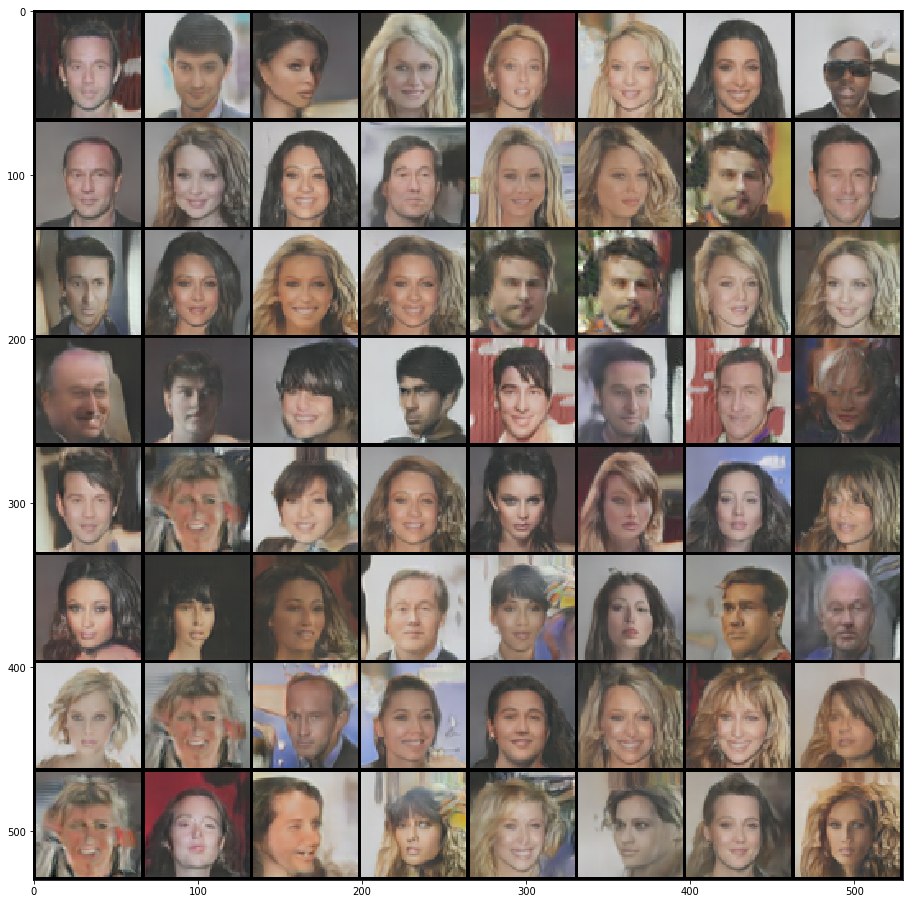

In [0]:
fixed_noise_1 = torch.randn(64, nz, 1, 1, device=device)
fig = plt.figure(figsize=(16,16))
fake = netG(fixed_noise_1).detach().cpu()
plt.imshow(np.transpose(vision_utils.make_grid(fake.to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

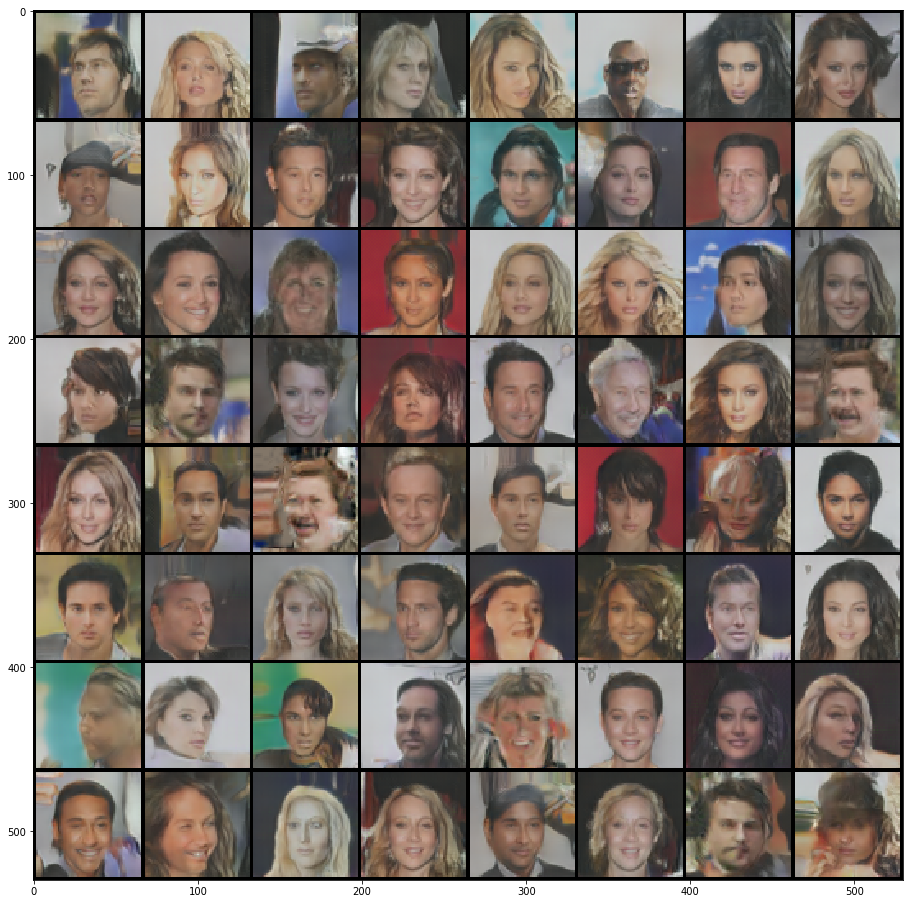

In [0]:
netG.eval()
# netG.train()
# Sampling fake images
fig = plt.figure(figsize=(16,16))

fixed_noise = noise_set[6800:6864]
fake = netG(fixed_noise).detach().cpu()
plt.imshow(np.transpose(vision_utils.make_grid(fake.to(device), padding=2, normalize=True).cpu(),(1,2,0)))

In [0]:
torch.save(netD.state_dict(), "./netD-gan-final.pth".format(i))
torch.save(netG.state_dict(), "./netG-gan-final.pth".format(i))
shutil.copy("./netD-gan-final.pth".format(i), './drive/My Drive/')
shutil.copy("./netG-gan-final.pth".format(i), './drive/My Drive/')

'./drive/My Drive/netG-gan-final.pth'

In [0]:
np.save('gan-G_losses.npy', np.array(G_losses))
np.save('gan-C_losses.npy', np.array(C_losses))
np.save('gan-C_losses_fake.npy', C_losses_fake)
np.save('gan-C_losses_real.npy', C_losses_real)

In [0]:
shutil.copy('gan-G_losses.npy', './drive/My Drive/')
shutil.copy('gan-C_losses.npy', './drive/My Drive/')
shutil.copy('gan-C_losses_real.npy', './drive/My Drive/')
shutil.copy('gan-C_losses_fake.npy', './drive/My Drive/')

'./drive/My Drive/gan-C_losses_fake.npy'

In [0]:
for i in range(len(img_list)):
  img_list[i] = img_list[i].numpy()

In [0]:
np.save('gan-img_list.npy', img_list)
shutil.copy('gan-img_list.npy', './drive/My Drive/')

'./drive/My Drive/gan-img_list.npy'